<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
!pip install --upgrade tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
len(X_train)

919

In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [17]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [18]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_EFFNET/model_EFFNET.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    include_optimizer=False,
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
effnet = EfficientNetV2B0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

24274472/24274472 [==============================] - 3s 0us/step


In [24]:
def get_config(self):
    config = super().get_config()
    return config

In [25]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/150
52/52 [==============================] - ETA: 0s - loss: 48.4191 - IoU: 5.0994e-04
Epoch 1: val_loss improved from inf to 41.78972, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 28ms/step


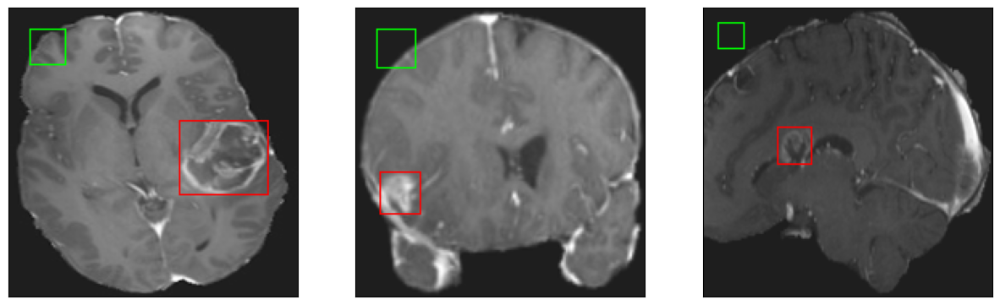

52/52 [==============================] - 83s 347ms/step - loss: 48.4191 - IoU: 5.0994e-04 - val_loss: 41.7897 - val_IoU: 2.1103e-04
Epoch 2/150
52/52 [==============================] - ETA: 0s - loss: 28.9126 - IoU: 0.0380
Epoch 2: val_loss improved from 41.78972 to 22.46929, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


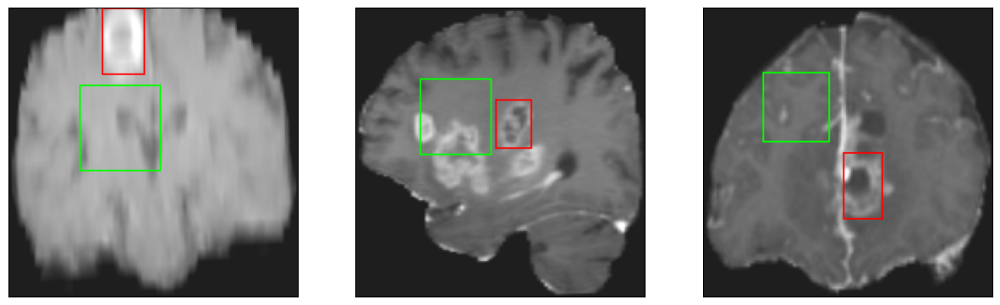

52/52 [==============================] - 7s 145ms/step - loss: 28.9126 - IoU: 0.0380 - val_loss: 22.4693 - val_IoU: 0.1018
Epoch 3/150
52/52 [==============================] - ETA: 0s - loss: 20.6086 - IoU: 0.0936
Epoch 3: val_loss improved from 22.46929 to 22.13287, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


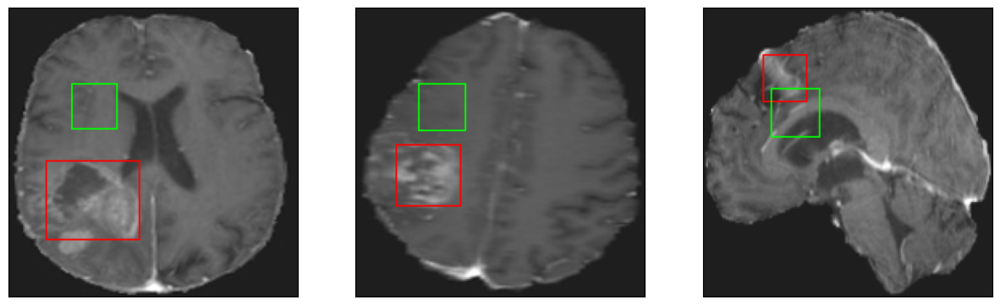

52/52 [==============================] - 7s 144ms/step - loss: 20.6086 - IoU: 0.0936 - val_loss: 22.1329 - val_IoU: 0.0534
Epoch 4/150
52/52 [==============================] - ETA: 0s - loss: 17.3534 - IoU: 0.1211
Epoch 4: val_loss improved from 22.13287 to 15.82387, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


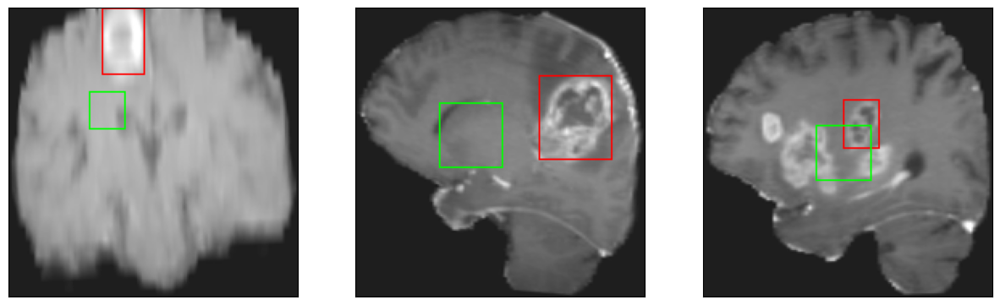

52/52 [==============================] - 7s 133ms/step - loss: 17.3534 - IoU: 0.1211 - val_loss: 15.8239 - val_IoU: 0.1451
Epoch 5/150
52/52 [==============================] - ETA: 0s - loss: 14.8927 - IoU: 0.1710
Epoch 5: val_loss improved from 15.82387 to 13.71195, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


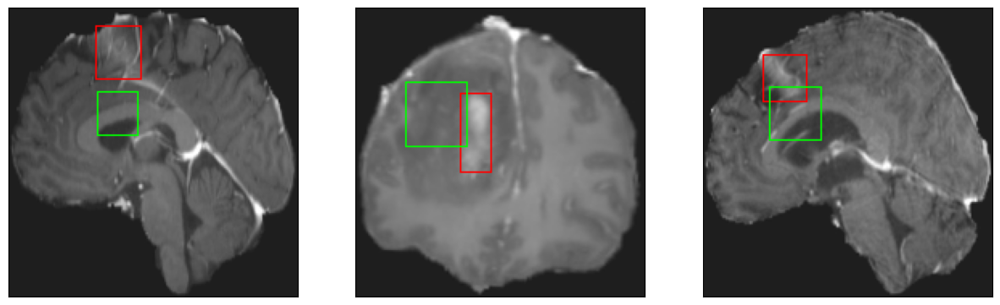

52/52 [==============================] - 8s 146ms/step - loss: 14.8927 - IoU: 0.1710 - val_loss: 13.7119 - val_IoU: 0.1734
Epoch 6/150
52/52 [==============================] - ETA: 0s - loss: 13.3698 - IoU: 0.2084
Epoch 6: val_loss improved from 13.71195 to 12.57605, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


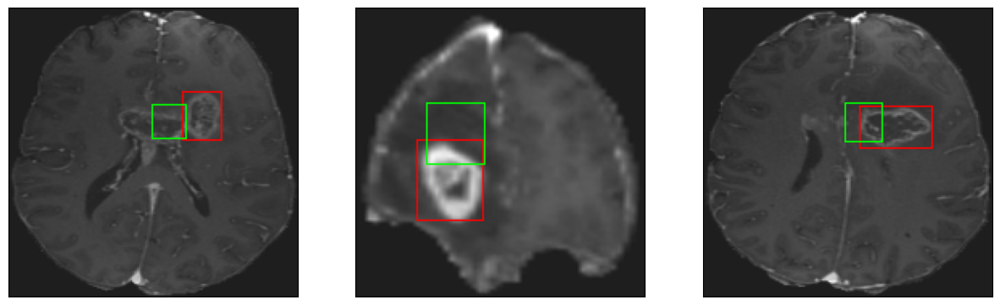

52/52 [==============================] - 9s 167ms/step - loss: 13.3698 - IoU: 0.2084 - val_loss: 12.5760 - val_IoU: 0.1724
Epoch 7/150
52/52 [==============================] - ETA: 0s - loss: 11.0809 - IoU: 0.2771
Epoch 7: val_loss improved from 12.57605 to 11.86891, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


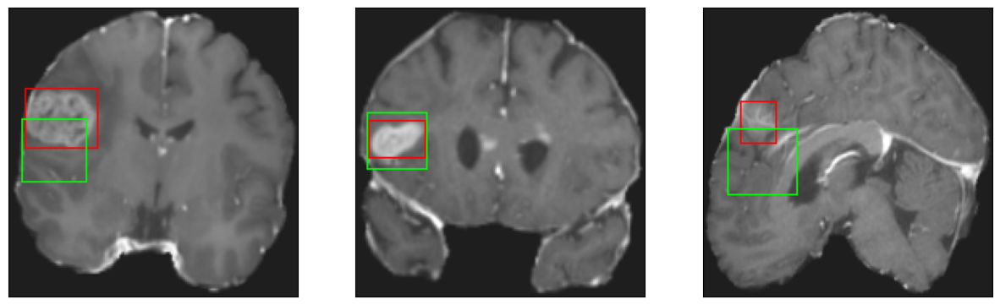

52/52 [==============================] - 7s 134ms/step - loss: 11.0809 - IoU: 0.2771 - val_loss: 11.8689 - val_IoU: 0.2381
Epoch 8/150
52/52 [==============================] - ETA: 0s - loss: 9.5931 - IoU: 0.3220
Epoch 8: val_loss improved from 11.86891 to 8.49614, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


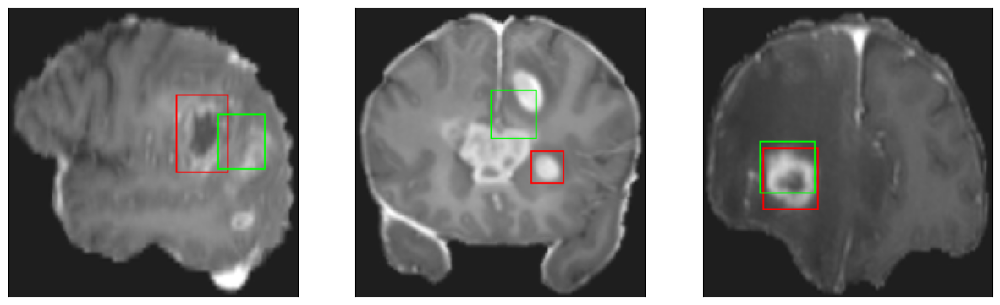

52/52 [==============================] - 8s 151ms/step - loss: 9.5931 - IoU: 0.3220 - val_loss: 8.4961 - val_IoU: 0.3887
Epoch 9/150
52/52 [==============================] - ETA: 0s - loss: 8.8258 - IoU: 0.3604
Epoch 9: val_loss improved from 8.49614 to 8.36218, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


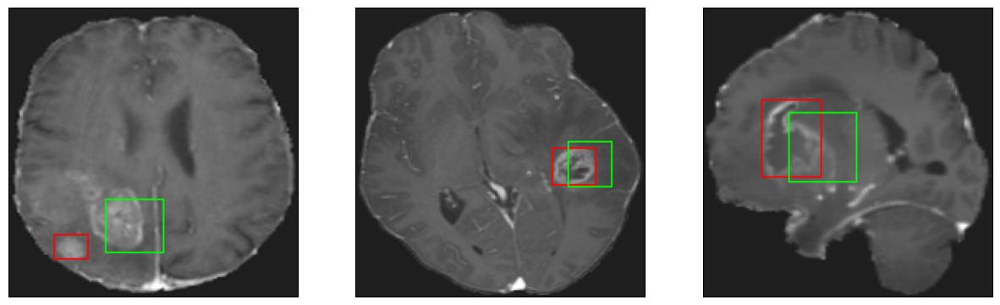

52/52 [==============================] - 7s 140ms/step - loss: 8.8258 - IoU: 0.3604 - val_loss: 8.3622 - val_IoU: 0.3581
Epoch 10/150
52/52 [==============================] - ETA: 0s - loss: 8.5206 - IoU: 0.3702
Epoch 10: val_loss improved from 8.36218 to 7.59088, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


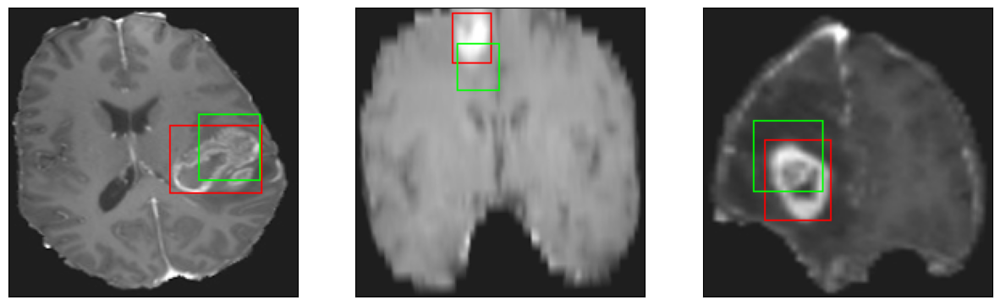

52/52 [==============================] - 7s 133ms/step - loss: 8.5206 - IoU: 0.3702 - val_loss: 7.5909 - val_IoU: 0.3906
Epoch 11/150
52/52 [==============================] - ETA: 0s - loss: 7.6131 - IoU: 0.4133
Epoch 11: val_loss did not improve from 7.59088
8/8 [==============================] - 0s 31ms/step


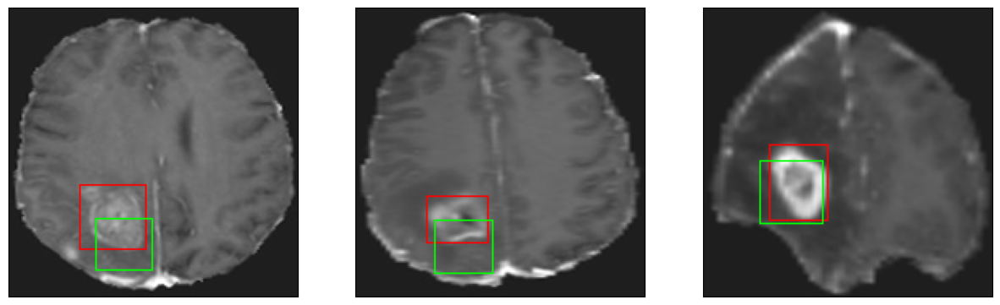

52/52 [==============================] - 7s 130ms/step - loss: 7.6131 - IoU: 0.4133 - val_loss: 7.9268 - val_IoU: 0.3914
Epoch 12/150
52/52 [==============================] - ETA: 0s - loss: 7.4585 - IoU: 0.4234
Epoch 12: val_loss improved from 7.59088 to 6.47685, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


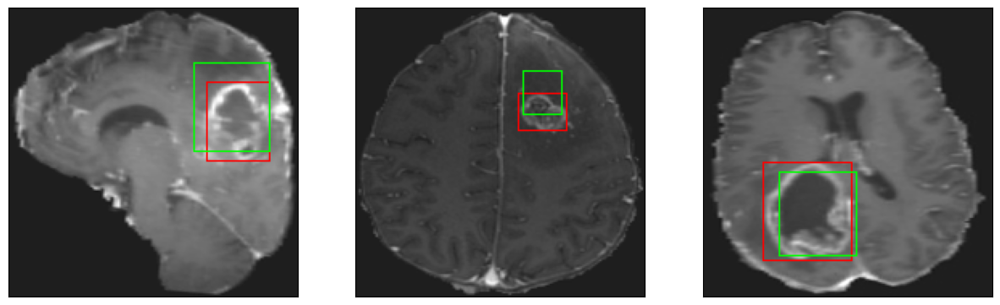

52/52 [==============================] - 8s 157ms/step - loss: 7.4585 - IoU: 0.4234 - val_loss: 6.4769 - val_IoU: 0.4894
Epoch 13/150
52/52 [==============================] - ETA: 0s - loss: 7.1210 - IoU: 0.4398
Epoch 13: val_loss improved from 6.47685 to 6.30561, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


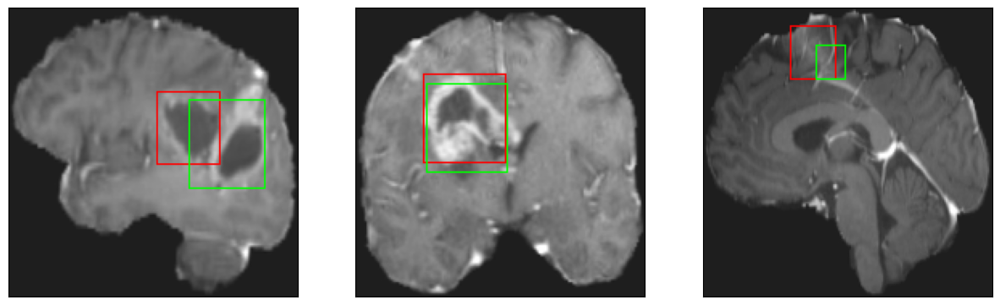

52/52 [==============================] - 8s 149ms/step - loss: 7.1210 - IoU: 0.4398 - val_loss: 6.3056 - val_IoU: 0.5108
Epoch 14/150
52/52 [==============================] - ETA: 0s - loss: 6.9790 - IoU: 0.4464
Epoch 14: val_loss did not improve from 6.30561
8/8 [==============================] - 0s 31ms/step


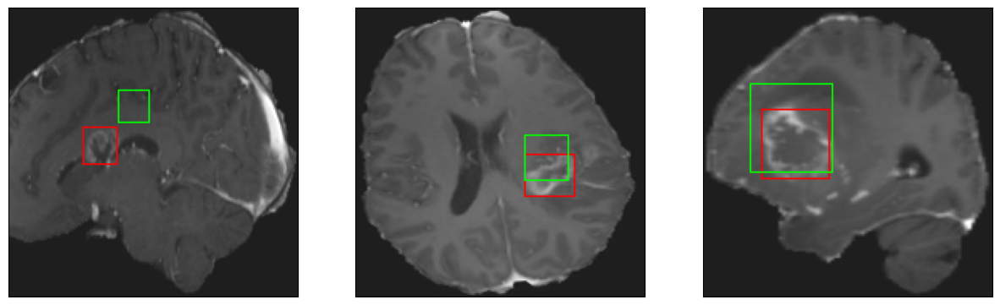

52/52 [==============================] - 7s 128ms/step - loss: 6.9790 - IoU: 0.4464 - val_loss: 7.2742 - val_IoU: 0.4398
Epoch 15/150
52/52 [==============================] - ETA: 0s - loss: 6.9886 - IoU: 0.4582
Epoch 15: val_loss did not improve from 6.30561
8/8 [==============================] - 0s 31ms/step


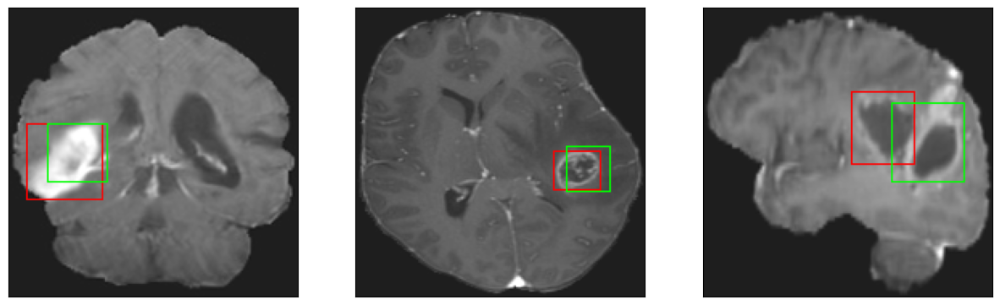

52/52 [==============================] - 6s 121ms/step - loss: 6.9886 - IoU: 0.4582 - val_loss: 7.2487 - val_IoU: 0.4444
Epoch 16/150
52/52 [==============================] - ETA: 0s - loss: 6.7119 - IoU: 0.4656
Epoch 16: val_loss did not improve from 6.30561
8/8 [==============================] - 0s 30ms/step


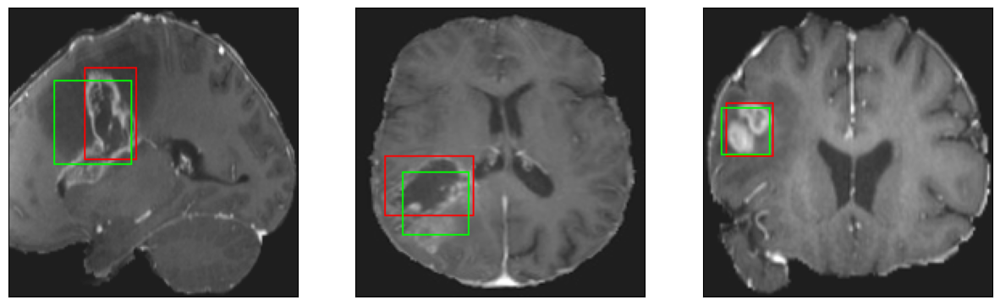

52/52 [==============================] - 6s 118ms/step - loss: 6.7119 - IoU: 0.4656 - val_loss: 6.4752 - val_IoU: 0.4843
Epoch 17/150
52/52 [==============================] - ETA: 0s - loss: 6.2951 - IoU: 0.4948
Epoch 17: val_loss did not improve from 6.30561
8/8 [==============================] - 0s 30ms/step


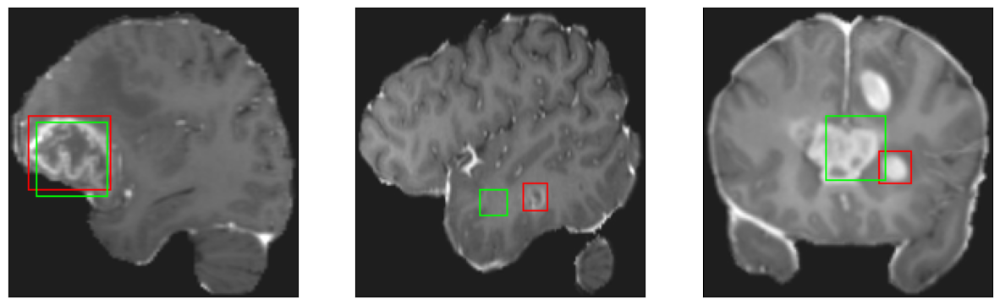

52/52 [==============================] - 7s 132ms/step - loss: 6.2951 - IoU: 0.4948 - val_loss: 6.3729 - val_IoU: 0.4904
Epoch 18/150
52/52 [==============================] - ETA: 0s - loss: 6.4976 - IoU: 0.4823
Epoch 18: val_loss improved from 6.30561 to 5.52901, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


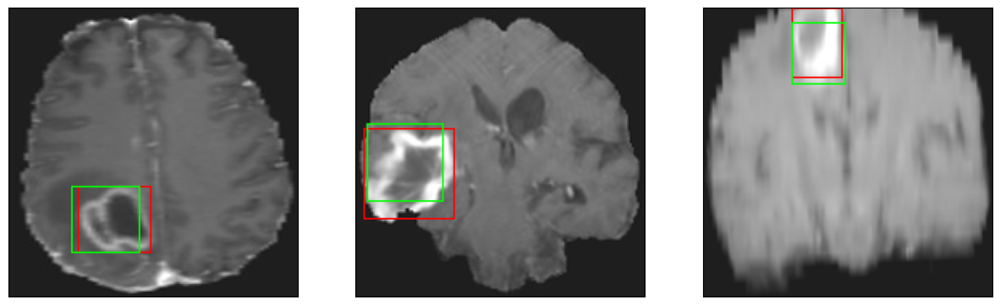

52/52 [==============================] - 9s 170ms/step - loss: 6.4976 - IoU: 0.4823 - val_loss: 5.5290 - val_IoU: 0.6058
Epoch 19/150
52/52 [==============================] - ETA: 0s - loss: 6.3581 - IoU: 0.4853
Epoch 19: val_loss did not improve from 5.52901
8/8 [==============================] - 0s 31ms/step


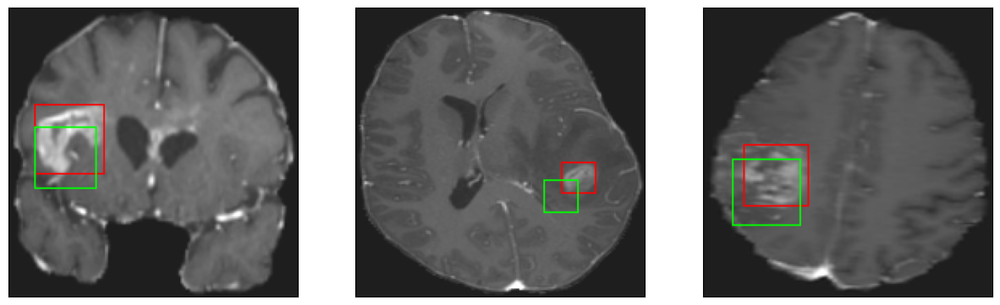

52/52 [==============================] - 6s 119ms/step - loss: 6.3581 - IoU: 0.4853 - val_loss: 8.4104 - val_IoU: 0.3266
Epoch 20/150
52/52 [==============================] - ETA: 0s - loss: 6.1792 - IoU: 0.4913
Epoch 20: val_loss did not improve from 5.52901
8/8 [==============================] - 0s 31ms/step


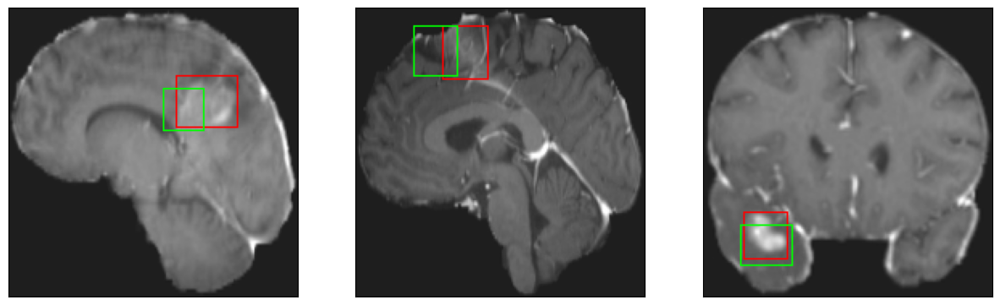

52/52 [==============================] - 6s 123ms/step - loss: 6.1792 - IoU: 0.4913 - val_loss: 8.1532 - val_IoU: 0.3383
Epoch 21/150
52/52 [==============================] - ETA: 0s - loss: 6.2501 - IoU: 0.4989
Epoch 21: val_loss improved from 5.52901 to 5.46161, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


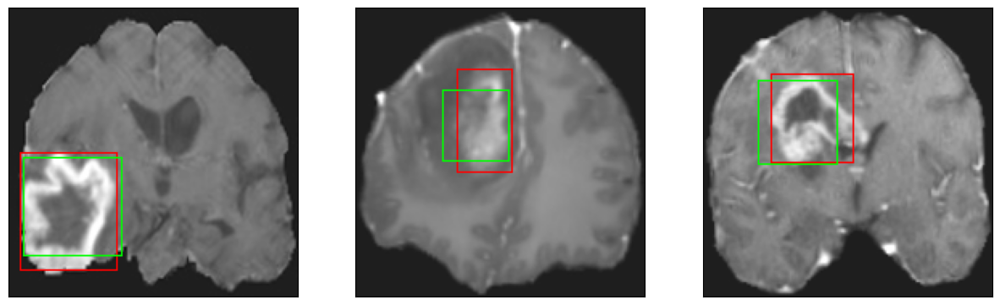

52/52 [==============================] - 9s 180ms/step - loss: 6.2501 - IoU: 0.4989 - val_loss: 5.4616 - val_IoU: 0.5587
Epoch 22/150
52/52 [==============================] - ETA: 0s - loss: 6.1058 - IoU: 0.5110
Epoch 22: val_loss did not improve from 5.46161
8/8 [==============================] - 0s 31ms/step


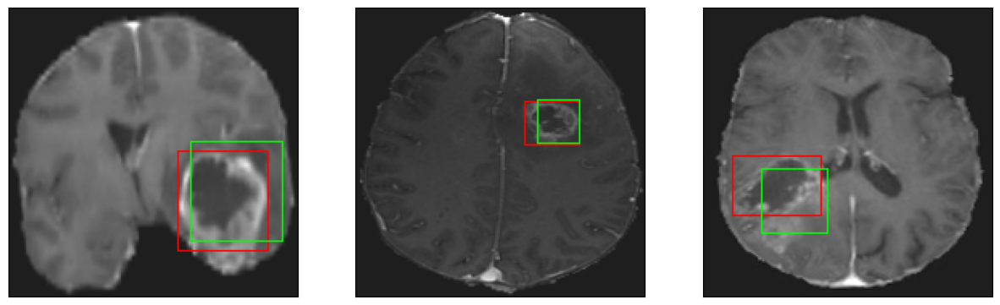

52/52 [==============================] - 6s 122ms/step - loss: 6.1058 - IoU: 0.5110 - val_loss: 6.3042 - val_IoU: 0.5044
Epoch 23/150
52/52 [==============================] - ETA: 0s - loss: 5.8917 - IoU: 0.5321
Epoch 23: val_loss improved from 5.46161 to 5.27118, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


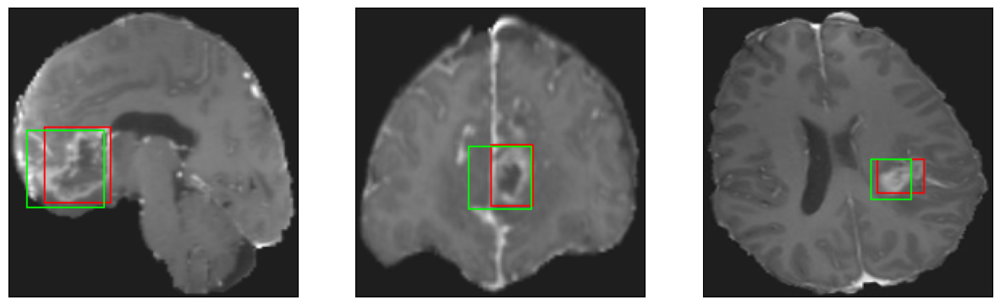

52/52 [==============================] - 10s 183ms/step - loss: 5.8917 - IoU: 0.5321 - val_loss: 5.2712 - val_IoU: 0.5960
Epoch 24/150
52/52 [==============================] - ETA: 0s - loss: 5.7863 - IoU: 0.5366
Epoch 24: val_loss did not improve from 5.27118
8/8 [==============================] - 0s 31ms/step


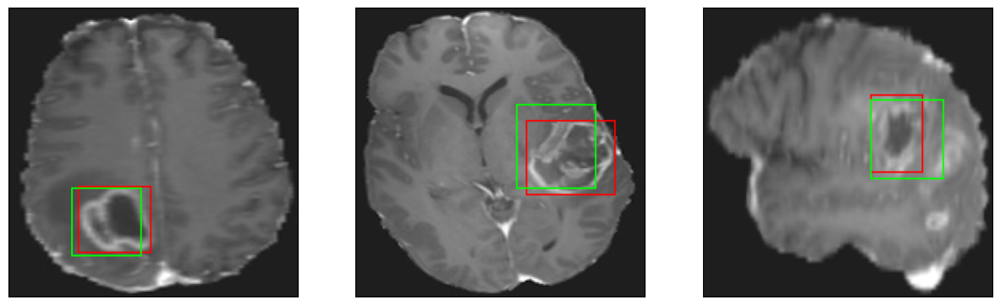

52/52 [==============================] - 7s 128ms/step - loss: 5.7863 - IoU: 0.5366 - val_loss: 6.5856 - val_IoU: 0.4979
Epoch 25/150
52/52 [==============================] - ETA: 0s - loss: 5.6161 - IoU: 0.5436
Epoch 25: val_loss did not improve from 5.27118
8/8 [==============================] - 0s 31ms/step


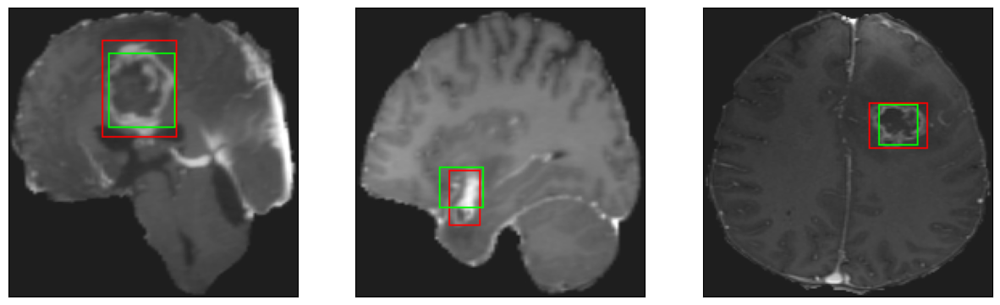

52/52 [==============================] - 7s 136ms/step - loss: 5.6161 - IoU: 0.5436 - val_loss: 6.2124 - val_IoU: 0.5474
Epoch 26/150
52/52 [==============================] - ETA: 0s - loss: 5.3179 - IoU: 0.5755
Epoch 26: val_loss did not improve from 5.27118
8/8 [==============================] - 0s 33ms/step


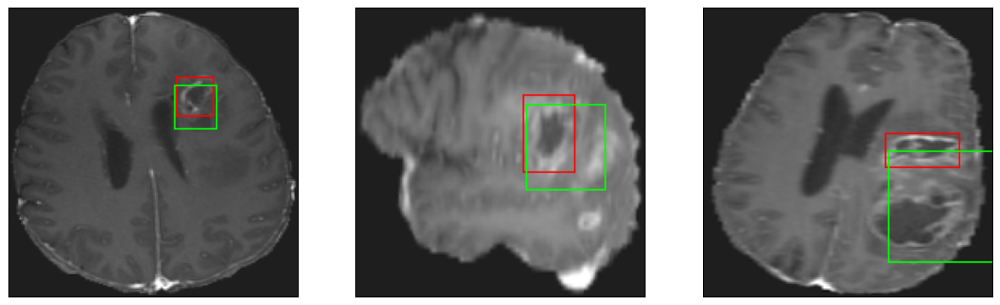

52/52 [==============================] - 7s 142ms/step - loss: 5.3179 - IoU: 0.5755 - val_loss: 5.7890 - val_IoU: 0.5663
Epoch 27/150
52/52 [==============================] - ETA: 0s - loss: 5.2883 - IoU: 0.5796
Epoch 27: val_loss did not improve from 5.27118
8/8 [==============================] - 0s 31ms/step


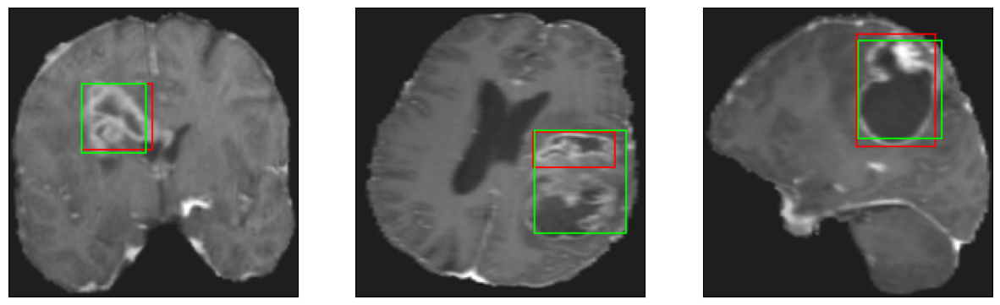

52/52 [==============================] - 6s 122ms/step - loss: 5.2883 - IoU: 0.5796 - val_loss: 5.4674 - val_IoU: 0.6001
Epoch 28/150
52/52 [==============================] - ETA: 0s - loss: 4.9414 - IoU: 0.5982
Epoch 28: val_loss improved from 5.27118 to 5.27095, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


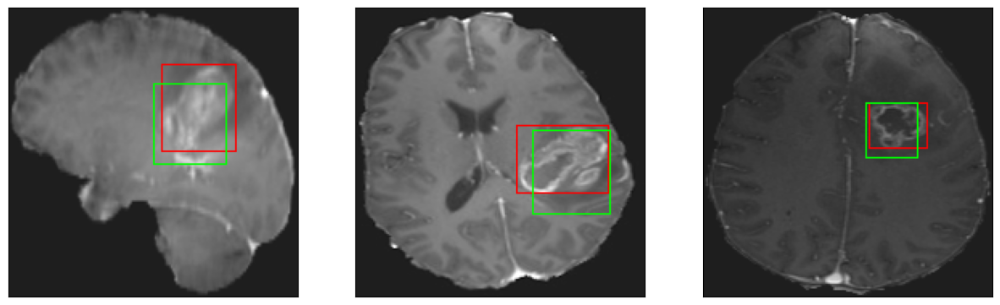

52/52 [==============================] - 9s 171ms/step - loss: 4.9414 - IoU: 0.5982 - val_loss: 5.2710 - val_IoU: 0.5939
Epoch 29/150
52/52 [==============================] - ETA: 0s - loss: 5.4777 - IoU: 0.5629
Epoch 29: val_loss did not improve from 5.27095
8/8 [==============================] - 0s 32ms/step


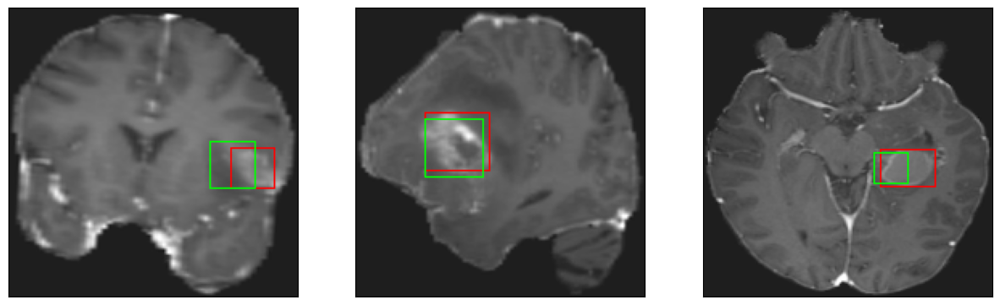

52/52 [==============================] - 7s 132ms/step - loss: 5.4777 - IoU: 0.5629 - val_loss: 5.5285 - val_IoU: 0.5473
Epoch 30/150
52/52 [==============================] - ETA: 0s - loss: 5.0279 - IoU: 0.5964
Epoch 30: val_loss did not improve from 5.27095
8/8 [==============================] - 0s 31ms/step


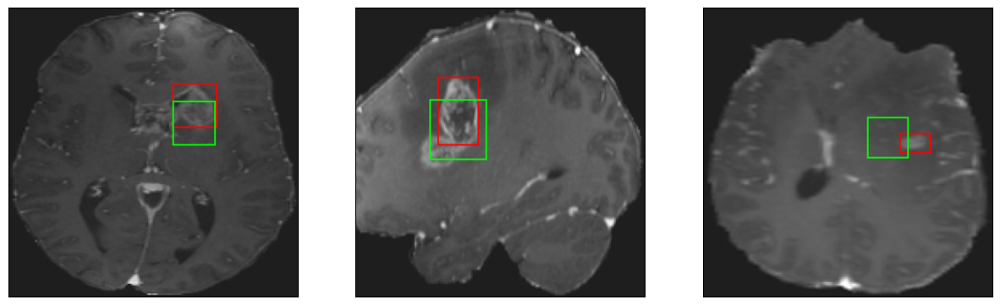

52/52 [==============================] - 6s 118ms/step - loss: 5.0279 - IoU: 0.5964 - val_loss: 5.6865 - val_IoU: 0.5790
Epoch 31/150
52/52 [==============================] - ETA: 0s - loss: 4.8324 - IoU: 0.6070
Epoch 31: val_loss did not improve from 5.27095
8/8 [==============================] - 0s 31ms/step


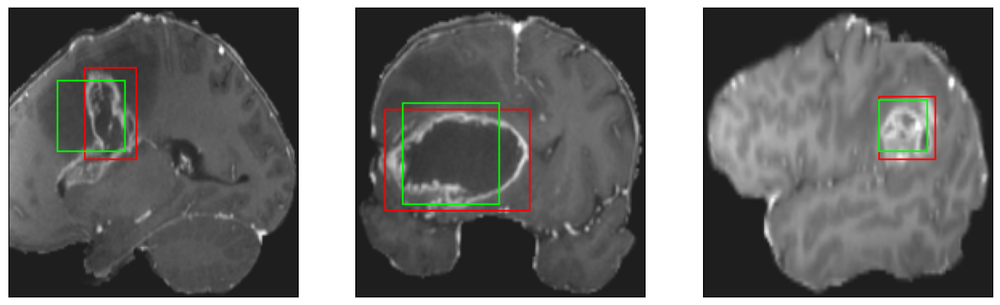

52/52 [==============================] - 6s 124ms/step - loss: 4.8324 - IoU: 0.6070 - val_loss: 5.4550 - val_IoU: 0.5914
Epoch 32/150
52/52 [==============================] - ETA: 0s - loss: 5.0426 - IoU: 0.5900
Epoch 32: val_loss improved from 5.27095 to 4.76372, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


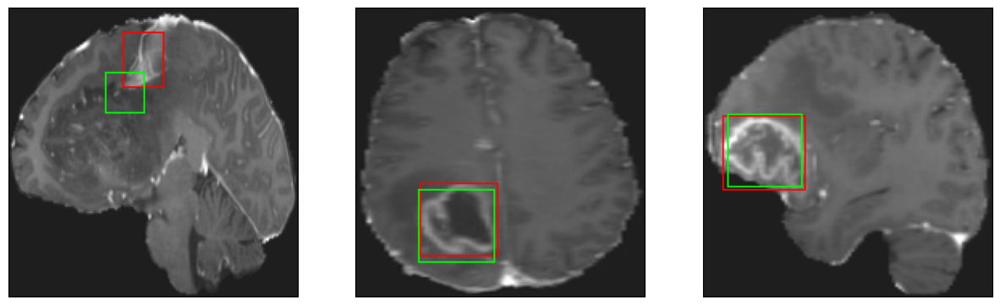

52/52 [==============================] - 10s 184ms/step - loss: 5.0426 - IoU: 0.5900 - val_loss: 4.7637 - val_IoU: 0.6391
Epoch 33/150
52/52 [==============================] - ETA: 0s - loss: 4.9851 - IoU: 0.6012
Epoch 33: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 31ms/step


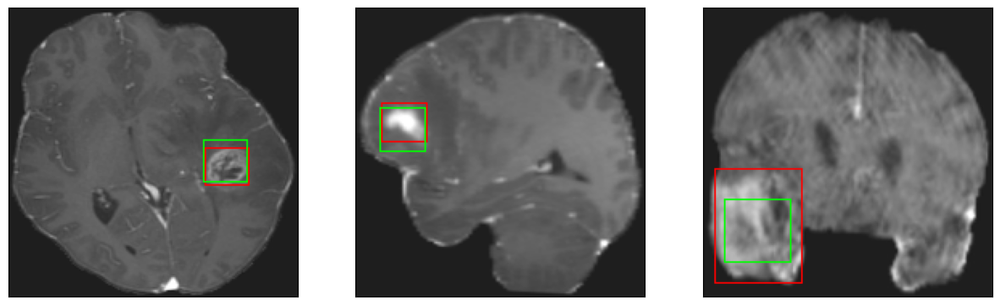

52/52 [==============================] - 8s 145ms/step - loss: 4.9851 - IoU: 0.6012 - val_loss: 5.2857 - val_IoU: 0.5911
Epoch 34/150
52/52 [==============================] - ETA: 0s - loss: 4.8003 - IoU: 0.6153
Epoch 34: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 31ms/step


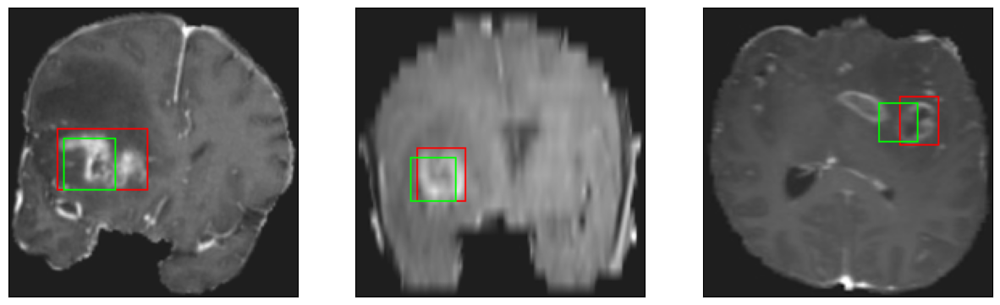

52/52 [==============================] - 6s 121ms/step - loss: 4.8003 - IoU: 0.6153 - val_loss: 6.3166 - val_IoU: 0.5108
Epoch 35/150
52/52 [==============================] - ETA: 0s - loss: 4.9036 - IoU: 0.6027
Epoch 35: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 30ms/step


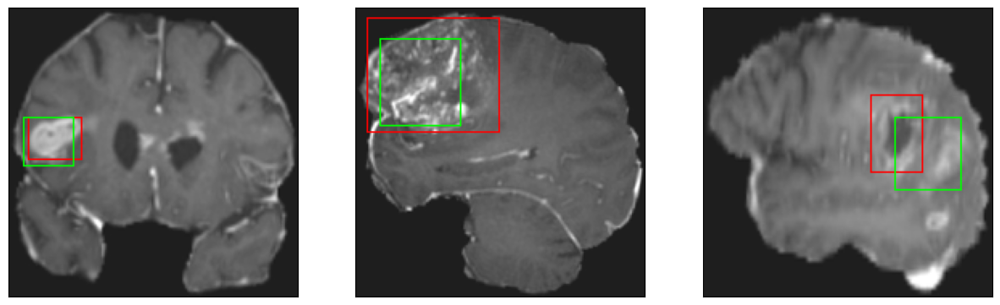

52/52 [==============================] - 7s 139ms/step - loss: 4.9036 - IoU: 0.6027 - val_loss: 5.1283 - val_IoU: 0.6066
Epoch 36/150
52/52 [==============================] - ETA: 0s - loss: 4.9069 - IoU: 0.6046
Epoch 36: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 30ms/step


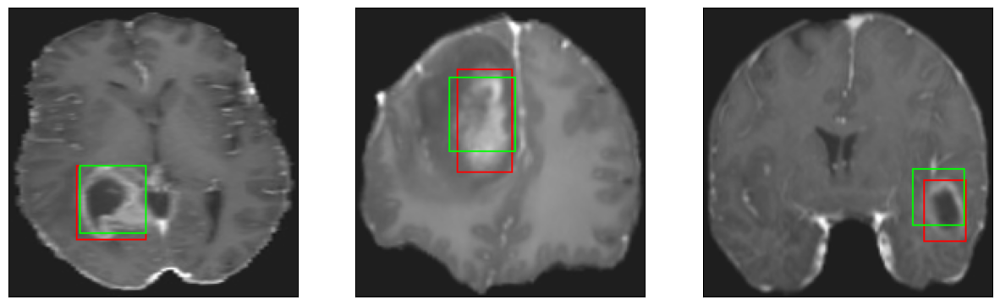

52/52 [==============================] - 6s 124ms/step - loss: 4.9069 - IoU: 0.6046 - val_loss: 5.7264 - val_IoU: 0.5625
Epoch 37/150
52/52 [==============================] - ETA: 0s - loss: 4.7200 - IoU: 0.6103
Epoch 37: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 33ms/step


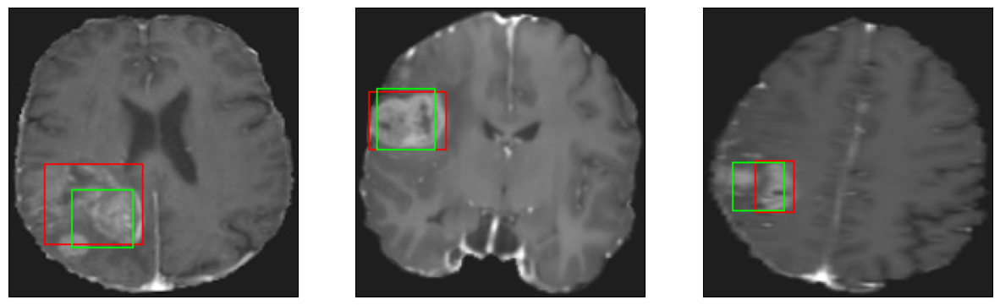

52/52 [==============================] - 7s 138ms/step - loss: 4.7200 - IoU: 0.6103 - val_loss: 5.9873 - val_IoU: 0.5104
Epoch 38/150
52/52 [==============================] - ETA: 0s - loss: 4.8710 - IoU: 0.6131
Epoch 38: val_loss did not improve from 4.76372
8/8 [==============================] - 0s 30ms/step


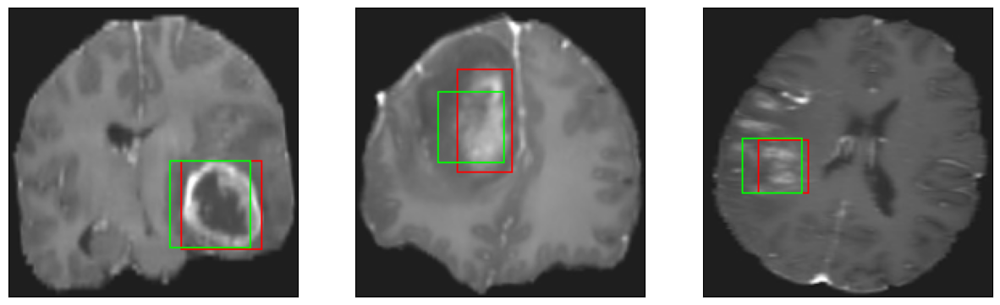

52/52 [==============================] - 7s 126ms/step - loss: 4.8710 - IoU: 0.6131 - val_loss: 5.8068 - val_IoU: 0.5301
Epoch 39/150
52/52 [==============================] - ETA: 0s - loss: 4.7758 - IoU: 0.6150
Epoch 39: val_loss improved from 4.76372 to 4.56135, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


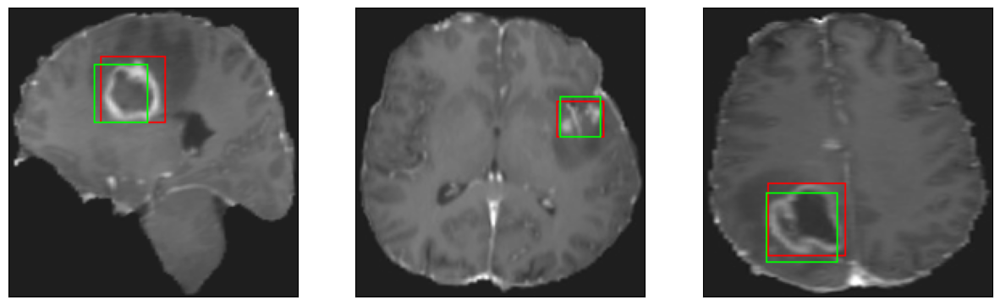

52/52 [==============================] - 10s 192ms/step - loss: 4.7758 - IoU: 0.6150 - val_loss: 4.5613 - val_IoU: 0.6588
Epoch 40/150
52/52 [==============================] - ETA: 0s - loss: 4.6029 - IoU: 0.6166
Epoch 40: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 31ms/step


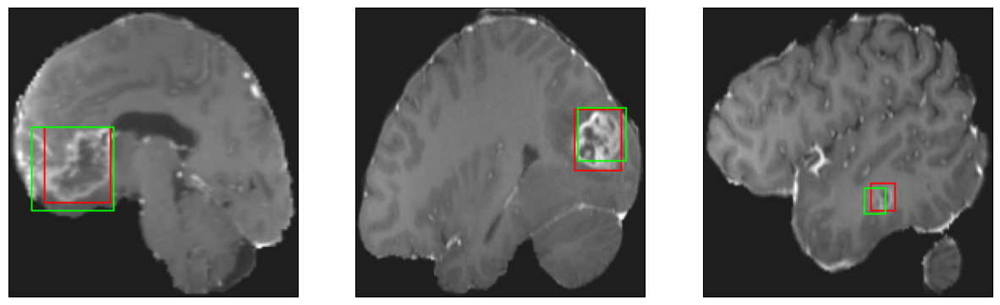

52/52 [==============================] - 7s 130ms/step - loss: 4.6029 - IoU: 0.6166 - val_loss: 4.7215 - val_IoU: 0.6330
Epoch 41/150
52/52 [==============================] - ETA: 0s - loss: 4.4703 - IoU: 0.6344
Epoch 41: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


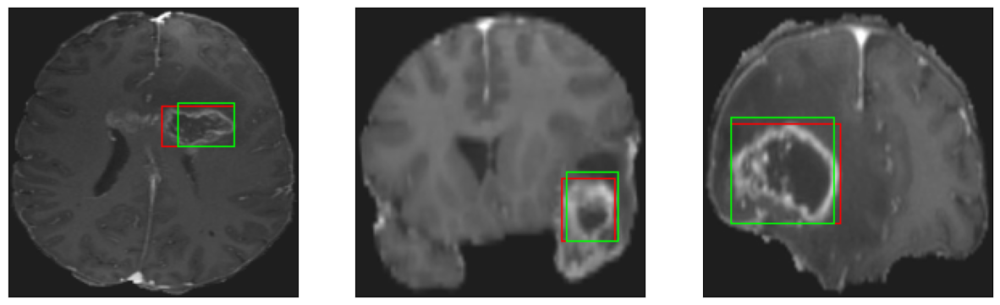

52/52 [==============================] - 6s 125ms/step - loss: 4.4703 - IoU: 0.6344 - val_loss: 4.8609 - val_IoU: 0.6262
Epoch 42/150
52/52 [==============================] - ETA: 0s - loss: 4.4032 - IoU: 0.6290
Epoch 42: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 31ms/step


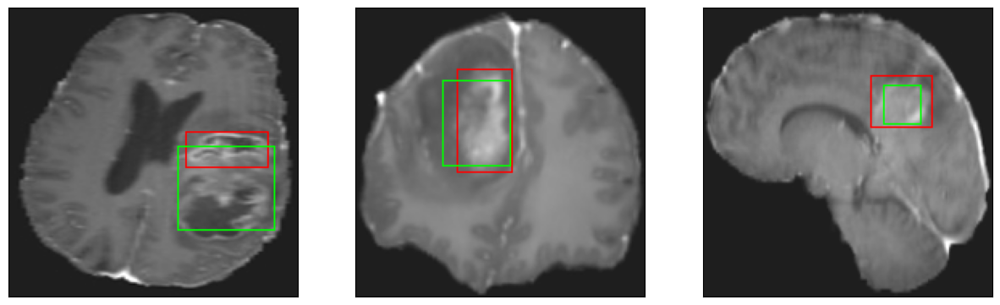

52/52 [==============================] - 7s 138ms/step - loss: 4.4032 - IoU: 0.6290 - val_loss: 4.6499 - val_IoU: 0.6603
Epoch 43/150
52/52 [==============================] - ETA: 0s - loss: 4.7542 - IoU: 0.6190
Epoch 43: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


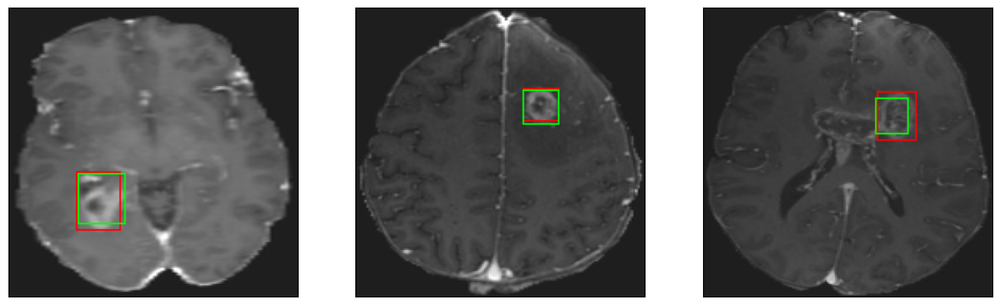

52/52 [==============================] - 7s 129ms/step - loss: 4.7542 - IoU: 0.6190 - val_loss: 4.9985 - val_IoU: 0.5878
Epoch 44/150
52/52 [==============================] - ETA: 0s - loss: 4.4038 - IoU: 0.6297
Epoch 44: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


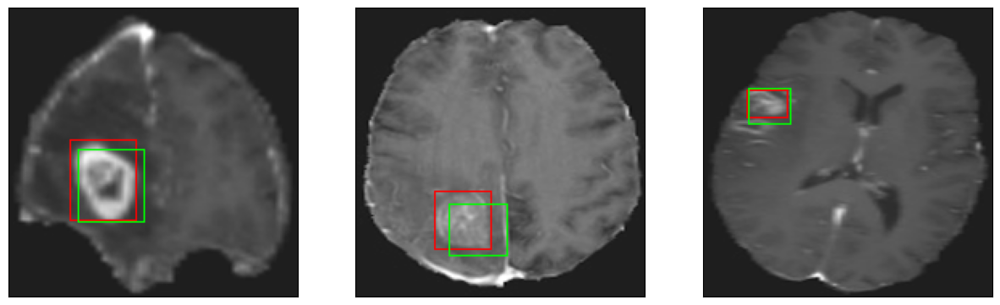

52/52 [==============================] - 6s 120ms/step - loss: 4.4038 - IoU: 0.6297 - val_loss: 5.2999 - val_IoU: 0.5610
Epoch 45/150
52/52 [==============================] - ETA: 0s - loss: 4.2680 - IoU: 0.6430
Epoch 45: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 31ms/step


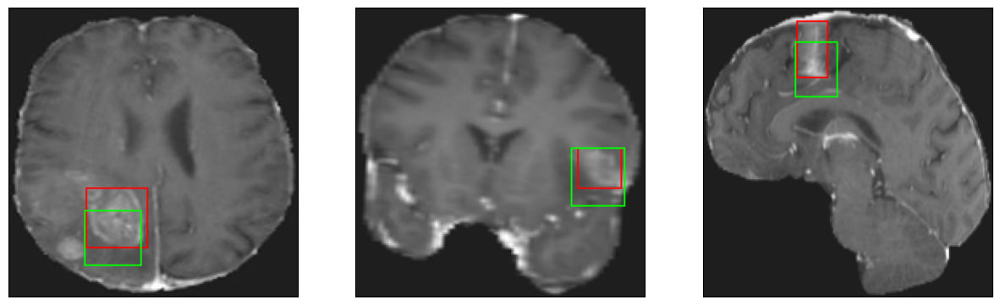

52/52 [==============================] - 7s 130ms/step - loss: 4.2680 - IoU: 0.6430 - val_loss: 4.9552 - val_IoU: 0.5991
Epoch 46/150
52/52 [==============================] - ETA: 0s - loss: 4.1626 - IoU: 0.6483
Epoch 46: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 34ms/step


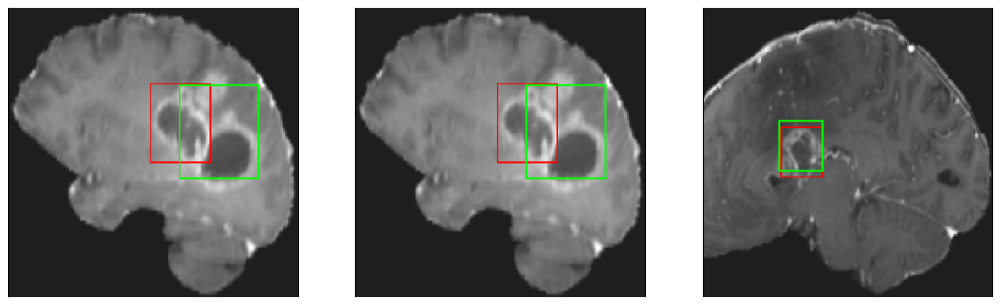

52/52 [==============================] - 7s 128ms/step - loss: 4.1626 - IoU: 0.6483 - val_loss: 5.0735 - val_IoU: 0.6191
Epoch 47/150
52/52 [==============================] - ETA: 0s - loss: 4.0415 - IoU: 0.6545
Epoch 47: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


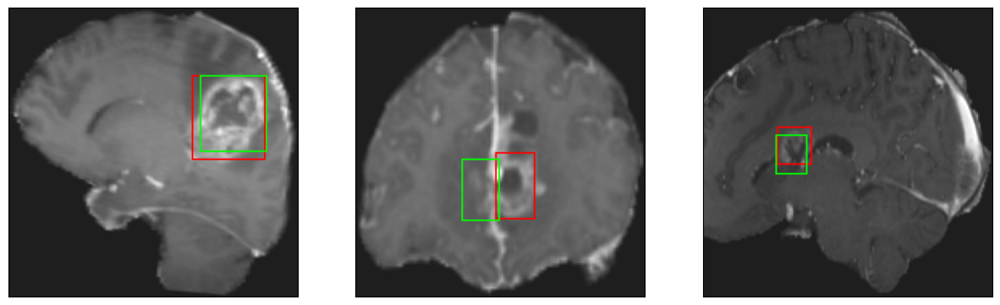

52/52 [==============================] - 8s 145ms/step - loss: 4.0415 - IoU: 0.6545 - val_loss: 5.3254 - val_IoU: 0.6116
Epoch 48/150
52/52 [==============================] - ETA: 0s - loss: 4.0745 - IoU: 0.6603
Epoch 48: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


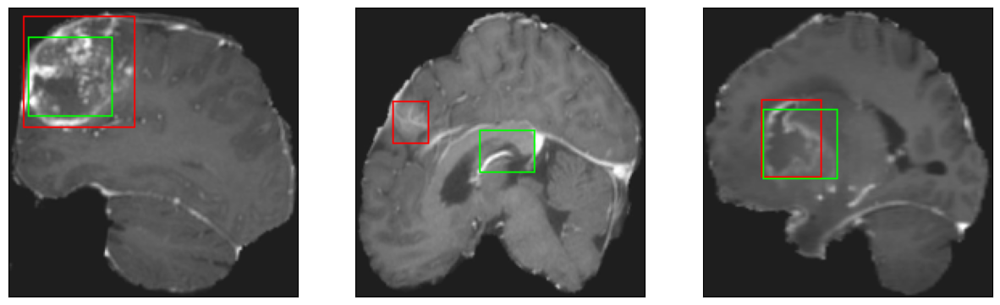

52/52 [==============================] - 6s 121ms/step - loss: 4.0745 - IoU: 0.6603 - val_loss: 4.8807 - val_IoU: 0.6187
Epoch 49/150
52/52 [==============================] - ETA: 0s - loss: 4.0140 - IoU: 0.6610
Epoch 49: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


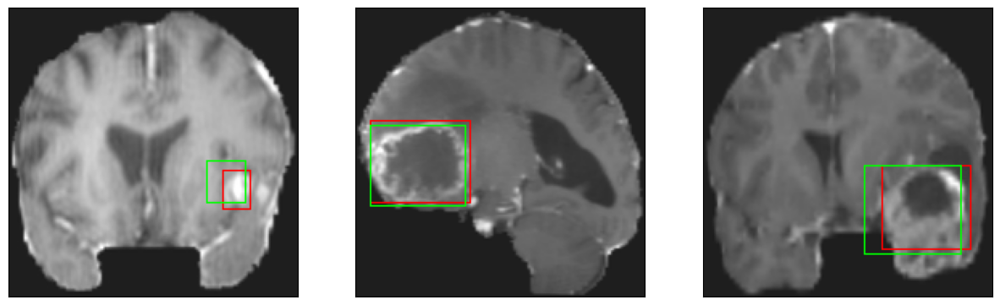

52/52 [==============================] - 7s 128ms/step - loss: 4.0140 - IoU: 0.6610 - val_loss: 4.5906 - val_IoU: 0.6603
Epoch 50/150
52/52 [==============================] - ETA: 0s - loss: 3.8192 - IoU: 0.6789
Epoch 50: val_loss did not improve from 4.56135
8/8 [==============================] - 0s 30ms/step


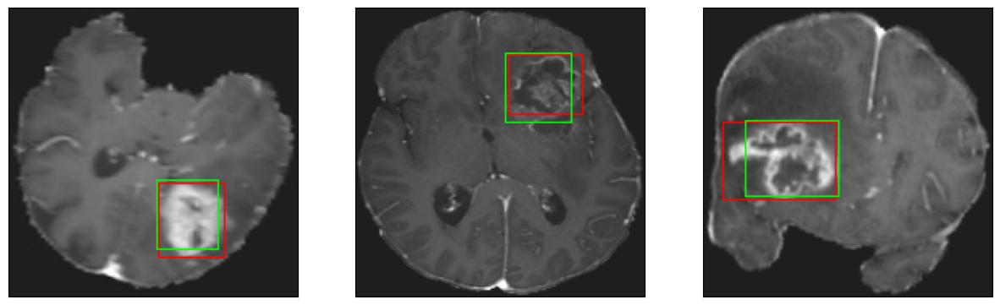

52/52 [==============================] - 7s 142ms/step - loss: 3.8192 - IoU: 0.6789 - val_loss: 4.8732 - val_IoU: 0.6127
Epoch 51/150
52/52 [==============================] - ETA: 0s - loss: 4.1112 - IoU: 0.6566
Epoch 51: val_loss improved from 4.56135 to 4.54385, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


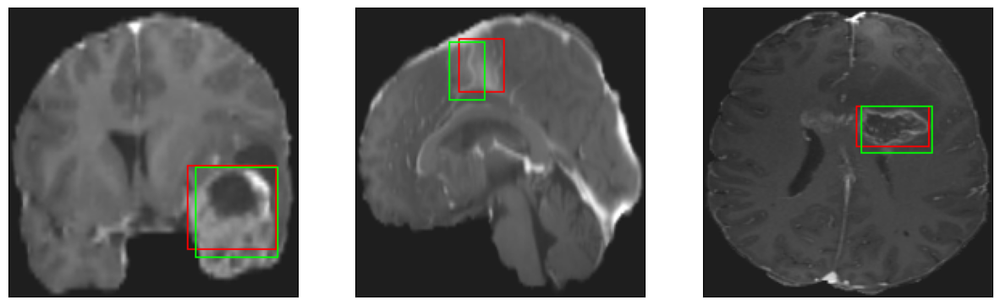

52/52 [==============================] - 10s 191ms/step - loss: 4.1112 - IoU: 0.6566 - val_loss: 4.5439 - val_IoU: 0.6397
Epoch 52/150
52/52 [==============================] - ETA: 0s - loss: 3.9129 - IoU: 0.6653
Epoch 52: val_loss did not improve from 4.54385
8/8 [==============================] - 0s 30ms/step


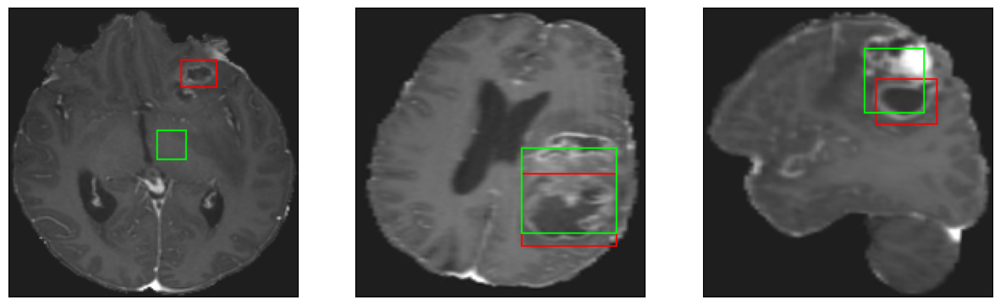

52/52 [==============================] - 6s 125ms/step - loss: 3.9129 - IoU: 0.6653 - val_loss: 4.5927 - val_IoU: 0.6457
Epoch 53/150
52/52 [==============================] - ETA: 0s - loss: 3.8646 - IoU: 0.6718
Epoch 53: val_loss improved from 4.54385 to 4.50839, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


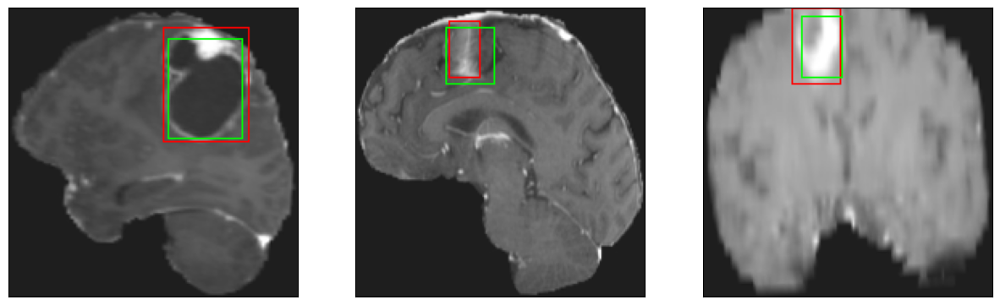

52/52 [==============================] - 10s 196ms/step - loss: 3.8646 - IoU: 0.6718 - val_loss: 4.5084 - val_IoU: 0.6665
Epoch 54/150
52/52 [==============================] - ETA: 0s - loss: 4.0062 - IoU: 0.6643
Epoch 54: val_loss did not improve from 4.50839
8/8 [==============================] - 0s 30ms/step


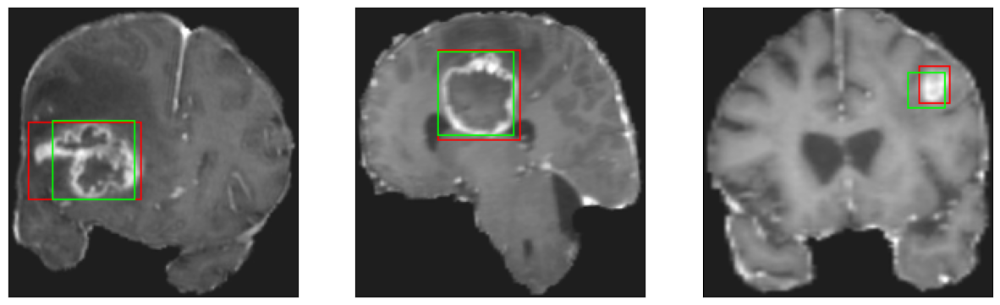

52/52 [==============================] - 6s 123ms/step - loss: 4.0062 - IoU: 0.6643 - val_loss: 4.5911 - val_IoU: 0.6561
Epoch 55/150
52/52 [==============================] - ETA: 0s - loss: 3.7912 - IoU: 0.6850
Epoch 55: val_loss improved from 4.50839 to 4.14567, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


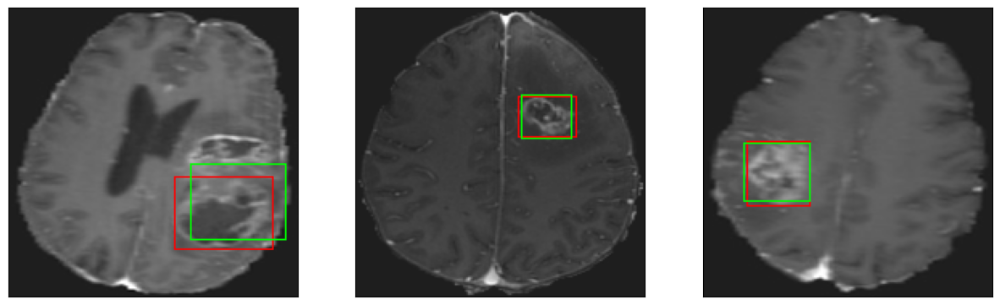

52/52 [==============================] - 9s 181ms/step - loss: 3.7912 - IoU: 0.6850 - val_loss: 4.1457 - val_IoU: 0.6962
Epoch 56/150
52/52 [==============================] - ETA: 0s - loss: 3.9434 - IoU: 0.6687
Epoch 56: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 30ms/step


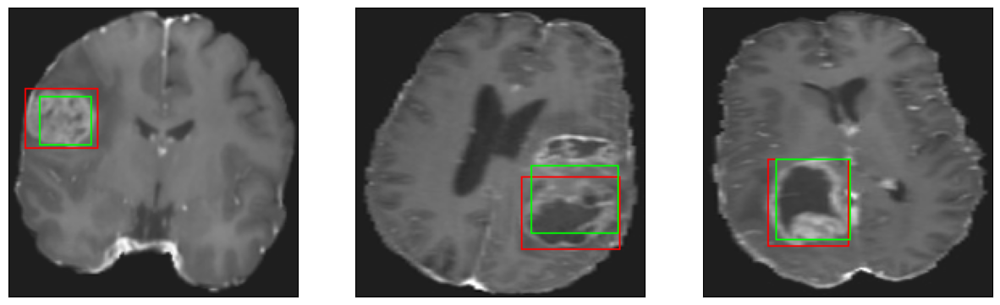

52/52 [==============================] - 6s 124ms/step - loss: 3.9434 - IoU: 0.6687 - val_loss: 5.7124 - val_IoU: 0.5757
Epoch 57/150
52/52 [==============================] - ETA: 0s - loss: 3.8271 - IoU: 0.6717
Epoch 57: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 31ms/step


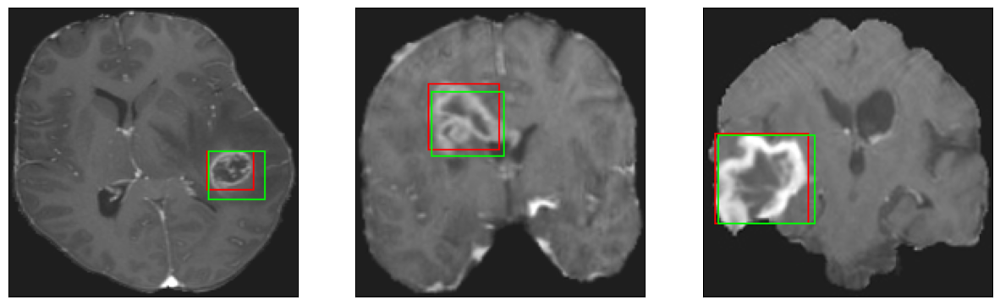

52/52 [==============================] - 7s 137ms/step - loss: 3.8271 - IoU: 0.6717 - val_loss: 4.9677 - val_IoU: 0.6217
Epoch 58/150
52/52 [==============================] - ETA: 0s - loss: 3.7789 - IoU: 0.6855
Epoch 58: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 32ms/step


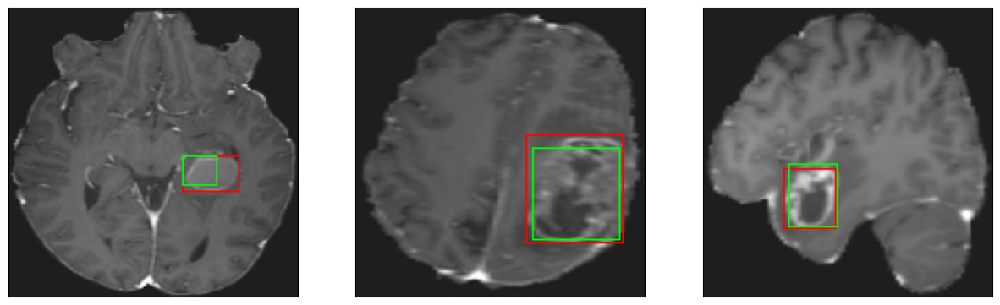

52/52 [==============================] - 7s 132ms/step - loss: 3.7789 - IoU: 0.6855 - val_loss: 4.1542 - val_IoU: 0.6718
Epoch 59/150
52/52 [==============================] - ETA: 0s - loss: 3.8774 - IoU: 0.6717
Epoch 59: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 30ms/step


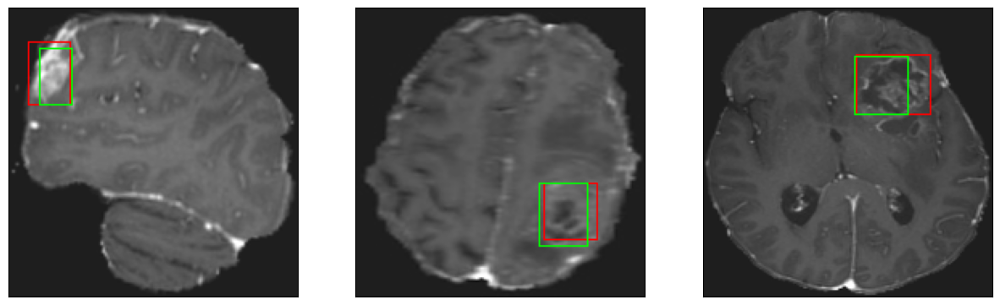

52/52 [==============================] - 7s 138ms/step - loss: 3.8774 - IoU: 0.6717 - val_loss: 4.9105 - val_IoU: 0.6062
Epoch 60/150
52/52 [==============================] - ETA: 0s - loss: 3.6444 - IoU: 0.6844
Epoch 60: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 30ms/step


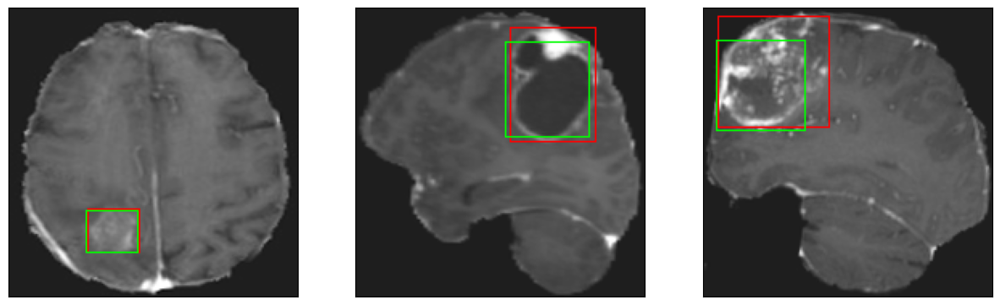

52/52 [==============================] - 7s 136ms/step - loss: 3.6444 - IoU: 0.6844 - val_loss: 4.1795 - val_IoU: 0.6764
Epoch 61/150
52/52 [==============================] - ETA: 0s - loss: 3.6836 - IoU: 0.6965
Epoch 61: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 31ms/step


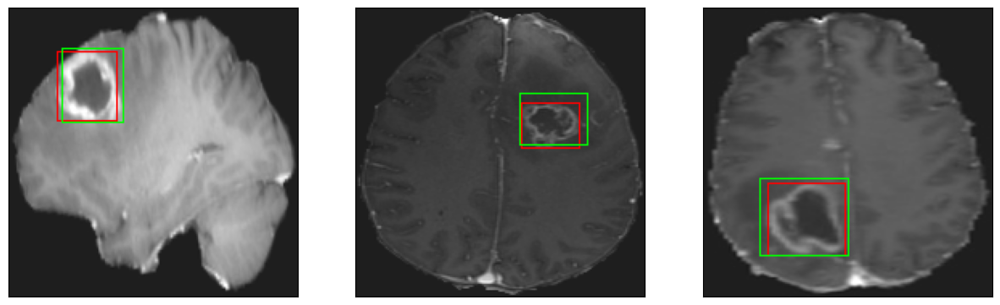

52/52 [==============================] - 6s 122ms/step - loss: 3.6836 - IoU: 0.6965 - val_loss: 4.4217 - val_IoU: 0.6679
Epoch 62/150
52/52 [==============================] - ETA: 0s - loss: 3.5150 - IoU: 0.7033
Epoch 62: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 30ms/step


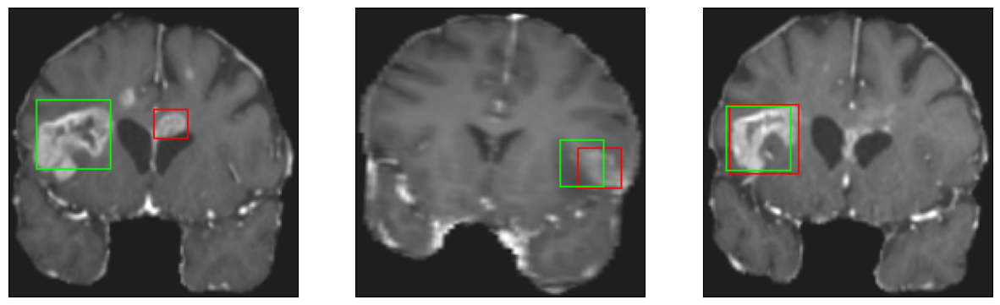

52/52 [==============================] - 7s 135ms/step - loss: 3.5150 - IoU: 0.7033 - val_loss: 4.6489 - val_IoU: 0.6179
Epoch 63/150
52/52 [==============================] - ETA: 0s - loss: 3.6799 - IoU: 0.7039
Epoch 63: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 31ms/step


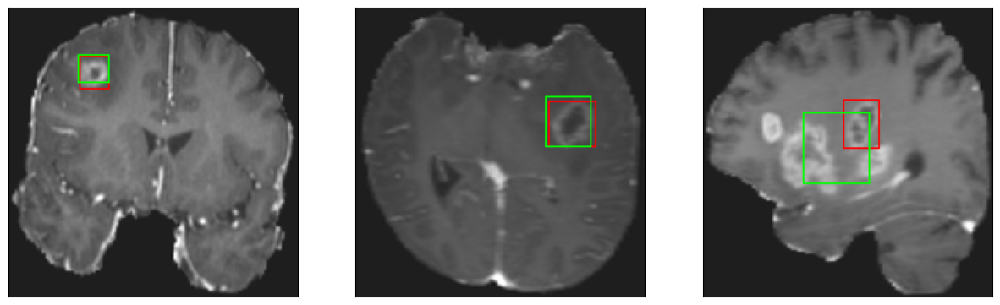

52/52 [==============================] - 7s 144ms/step - loss: 3.6799 - IoU: 0.7039 - val_loss: 4.1475 - val_IoU: 0.6901
Epoch 64/150
52/52 [==============================] - ETA: 0s - loss: 3.4641 - IoU: 0.7077
Epoch 64: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 30ms/step


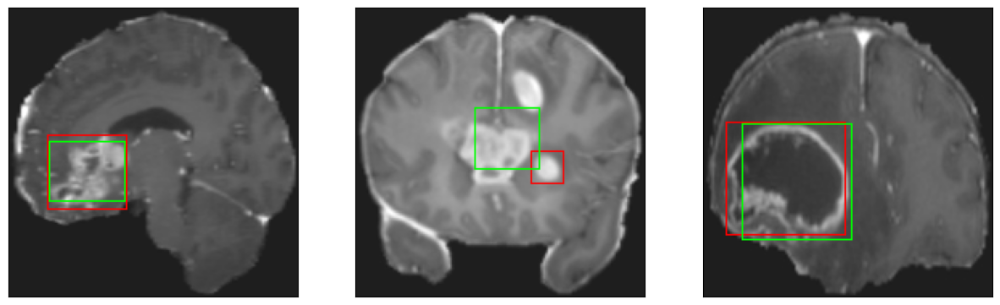

52/52 [==============================] - 7s 127ms/step - loss: 3.4641 - IoU: 0.7077 - val_loss: 4.4503 - val_IoU: 0.6421
Epoch 65/150
52/52 [==============================] - ETA: 0s - loss: 3.6553 - IoU: 0.6936
Epoch 65: val_loss did not improve from 4.14567
8/8 [==============================] - 0s 34ms/step


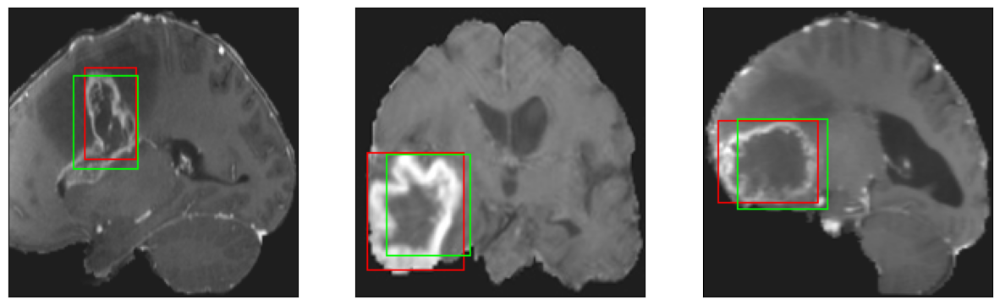

52/52 [==============================] - 7s 130ms/step - loss: 3.6553 - IoU: 0.6936 - val_loss: 5.5900 - val_IoU: 0.5151
Epoch 66/150
52/52 [==============================] - ETA: 0s - loss: 3.6339 - IoU: 0.6985
Epoch 66: val_loss improved from 4.14567 to 4.12901, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


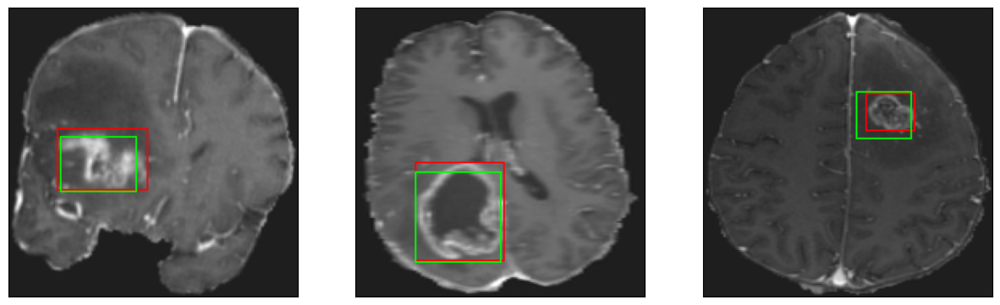

52/52 [==============================] - 9s 180ms/step - loss: 3.6339 - IoU: 0.6985 - val_loss: 4.1290 - val_IoU: 0.6871
Epoch 67/150
52/52 [==============================] - ETA: 0s - loss: 3.5567 - IoU: 0.6998
Epoch 67: val_loss did not improve from 4.12901
8/8 [==============================] - 0s 30ms/step


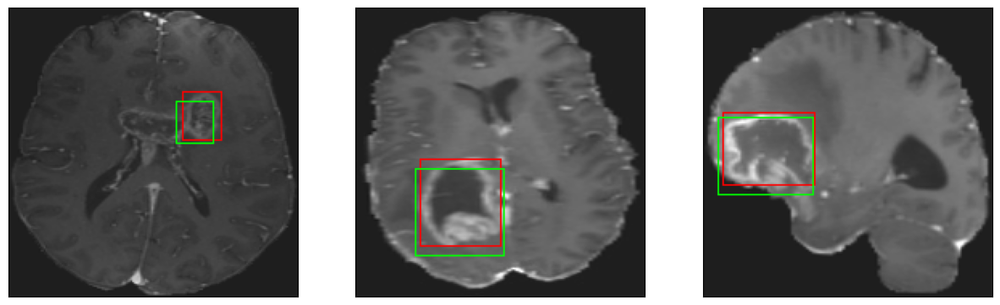

52/52 [==============================] - 7s 131ms/step - loss: 3.5567 - IoU: 0.6998 - val_loss: 4.6869 - val_IoU: 0.5918
Epoch 68/150
52/52 [==============================] - ETA: 0s - loss: 3.4734 - IoU: 0.6983
Epoch 68: val_loss did not improve from 4.12901
8/8 [==============================] - 0s 30ms/step


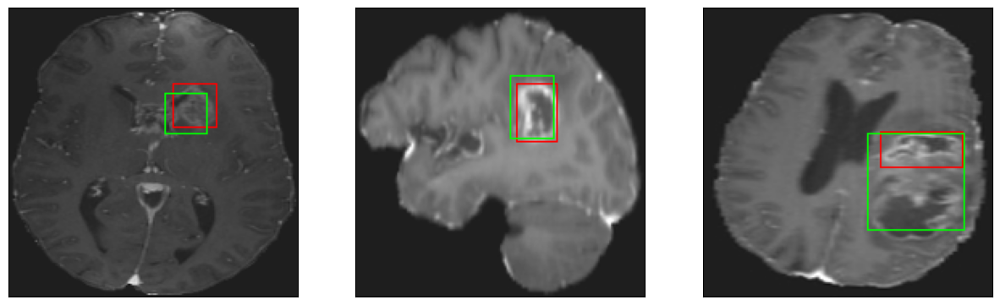

52/52 [==============================] - 7s 131ms/step - loss: 3.4734 - IoU: 0.6983 - val_loss: 4.5686 - val_IoU: 0.6486
Epoch 69/150
52/52 [==============================] - ETA: 0s - loss: 3.4827 - IoU: 0.7126
Epoch 69: val_loss improved from 4.12901 to 4.09181, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


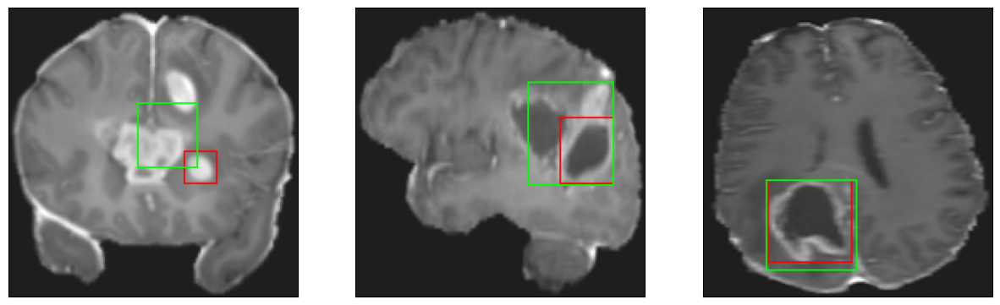

52/52 [==============================] - 9s 179ms/step - loss: 3.4827 - IoU: 0.7126 - val_loss: 4.0918 - val_IoU: 0.7062
Epoch 70/150
52/52 [==============================] - ETA: 0s - loss: 3.5412 - IoU: 0.7031
Epoch 70: val_loss improved from 4.09181 to 3.76656, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


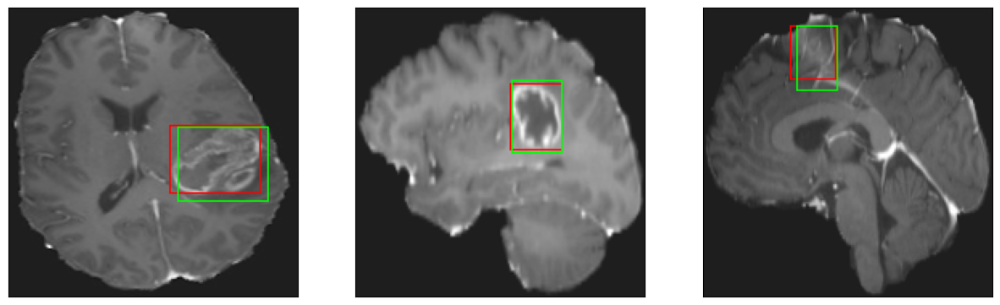

52/52 [==============================] - 9s 166ms/step - loss: 3.5412 - IoU: 0.7031 - val_loss: 3.7666 - val_IoU: 0.7142
Epoch 71/150
52/52 [==============================] - ETA: 0s - loss: 3.5641 - IoU: 0.7008
Epoch 71: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


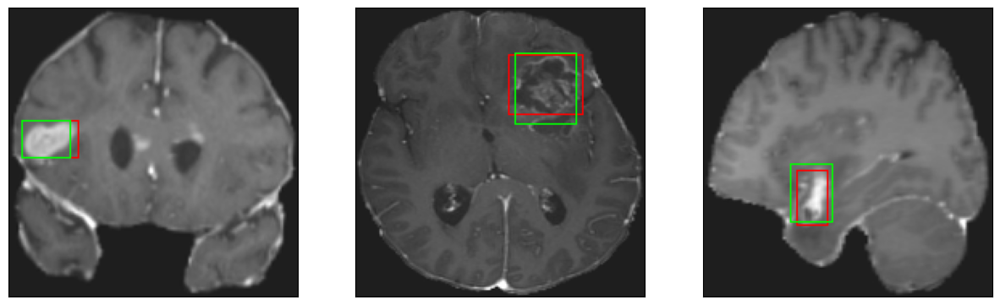

52/52 [==============================] - 6s 123ms/step - loss: 3.5641 - IoU: 0.7008 - val_loss: 4.0238 - val_IoU: 0.6978
Epoch 72/150
52/52 [==============================] - ETA: 0s - loss: 3.4516 - IoU: 0.7073
Epoch 72: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


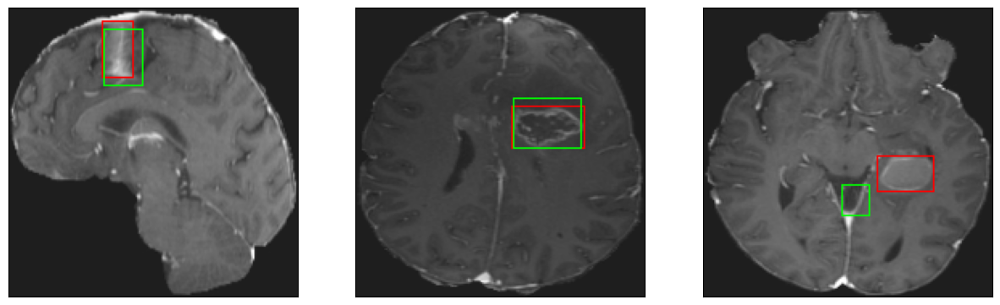

52/52 [==============================] - 7s 144ms/step - loss: 3.4516 - IoU: 0.7073 - val_loss: 4.0429 - val_IoU: 0.6884
Epoch 73/150
52/52 [==============================] - ETA: 0s - loss: 3.4286 - IoU: 0.7059
Epoch 73: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


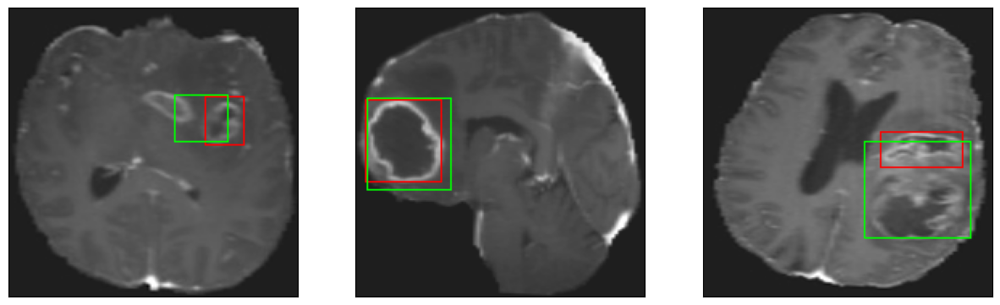

52/52 [==============================] - 6s 124ms/step - loss: 3.4286 - IoU: 0.7059 - val_loss: 4.5312 - val_IoU: 0.6510
Epoch 74/150
52/52 [==============================] - ETA: 0s - loss: 3.4325 - IoU: 0.7173
Epoch 74: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


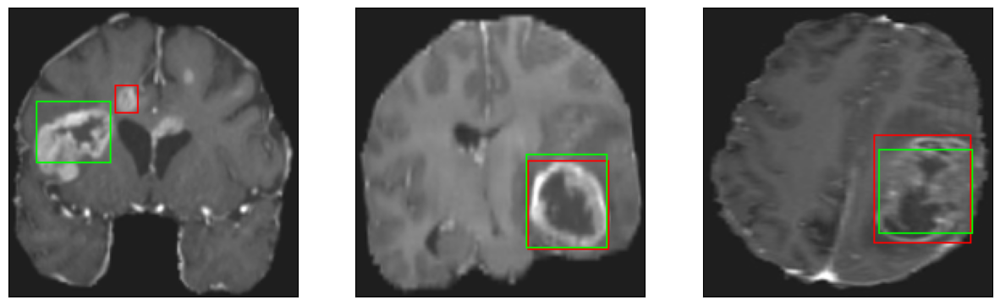

52/52 [==============================] - 7s 137ms/step - loss: 3.4325 - IoU: 0.7173 - val_loss: 4.6846 - val_IoU: 0.6418
Epoch 75/150
52/52 [==============================] - ETA: 0s - loss: 3.7915 - IoU: 0.7022
Epoch 75: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 33ms/step


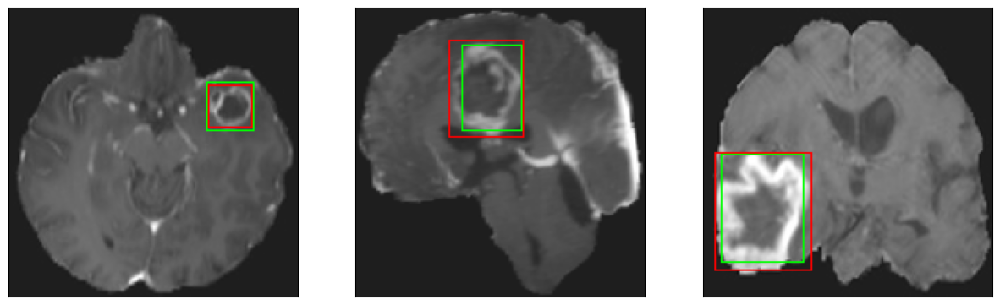

52/52 [==============================] - 7s 130ms/step - loss: 3.7915 - IoU: 0.7022 - val_loss: 4.5182 - val_IoU: 0.6571
Epoch 76/150
52/52 [==============================] - ETA: 0s - loss: 3.6213 - IoU: 0.7035
Epoch 76: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


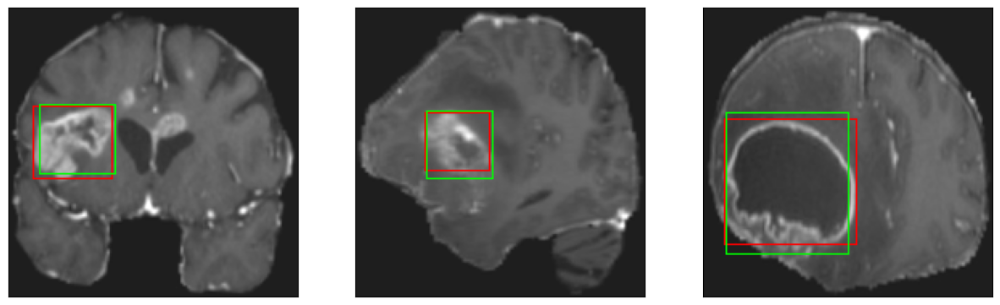

52/52 [==============================] - 7s 140ms/step - loss: 3.6213 - IoU: 0.7035 - val_loss: 4.5776 - val_IoU: 0.6870
Epoch 77/150
52/52 [==============================] - ETA: 0s - loss: 3.5500 - IoU: 0.7021
Epoch 77: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 33ms/step


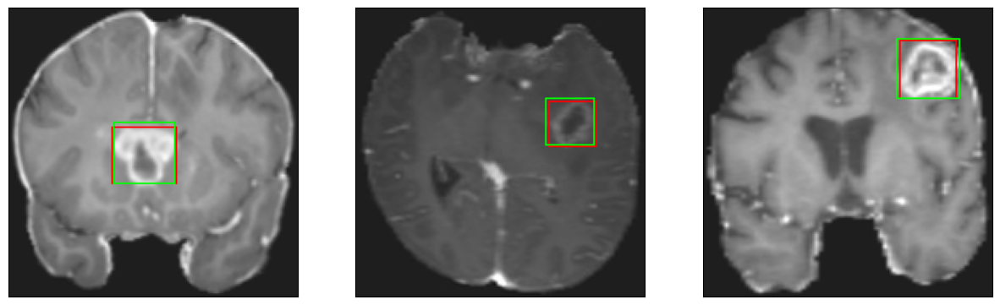

52/52 [==============================] - 7s 132ms/step - loss: 3.5500 - IoU: 0.7021 - val_loss: 4.0356 - val_IoU: 0.7044
Epoch 78/150
52/52 [==============================] - ETA: 0s - loss: 3.3482 - IoU: 0.7056
Epoch 78: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


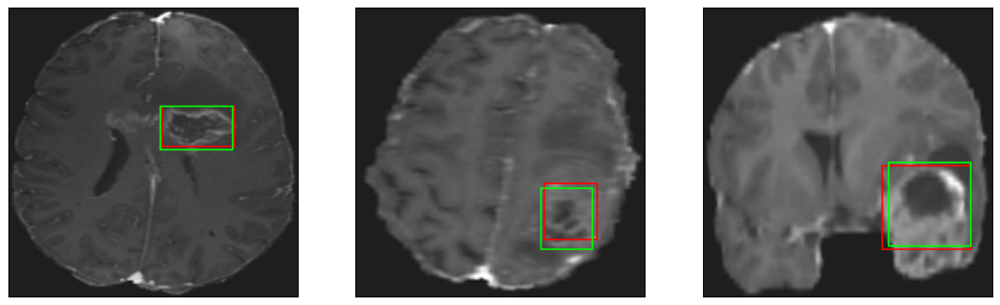

52/52 [==============================] - 7s 128ms/step - loss: 3.3482 - IoU: 0.7056 - val_loss: 4.1492 - val_IoU: 0.6819
Epoch 79/150
52/52 [==============================] - ETA: 0s - loss: 3.4754 - IoU: 0.7025
Epoch 79: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


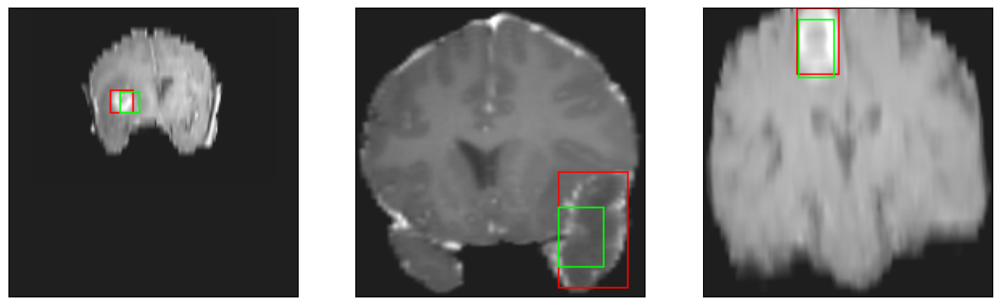

52/52 [==============================] - 7s 134ms/step - loss: 3.4754 - IoU: 0.7025 - val_loss: 4.4831 - val_IoU: 0.6649
Epoch 80/150
52/52 [==============================] - ETA: 0s - loss: 3.2455 - IoU: 0.7213
Epoch 80: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 33ms/step


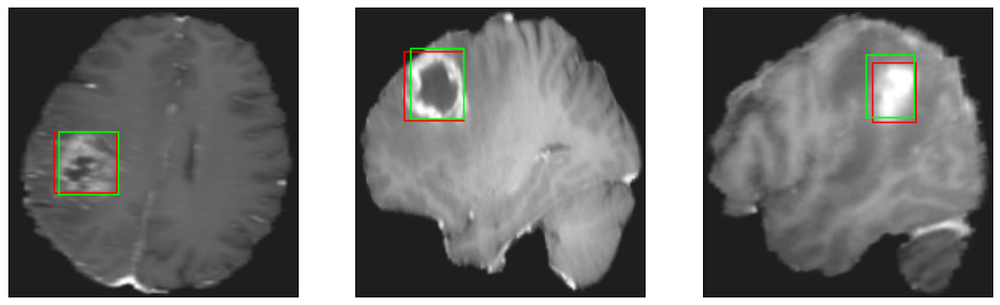

52/52 [==============================] - 7s 139ms/step - loss: 3.2455 - IoU: 0.7213 - val_loss: 4.2842 - val_IoU: 0.6545
Epoch 81/150
52/52 [==============================] - ETA: 0s - loss: 3.3750 - IoU: 0.7146
Epoch 81: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


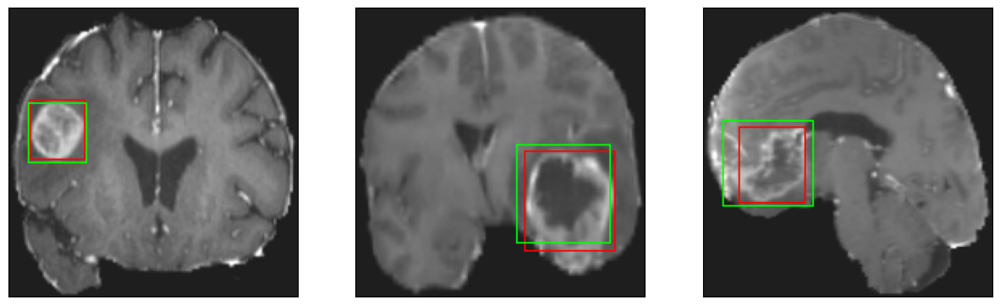

52/52 [==============================] - 6s 121ms/step - loss: 3.3750 - IoU: 0.7146 - val_loss: 4.0806 - val_IoU: 0.7059
Epoch 82/150
52/52 [==============================] - ETA: 0s - loss: 3.3539 - IoU: 0.7117
Epoch 82: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


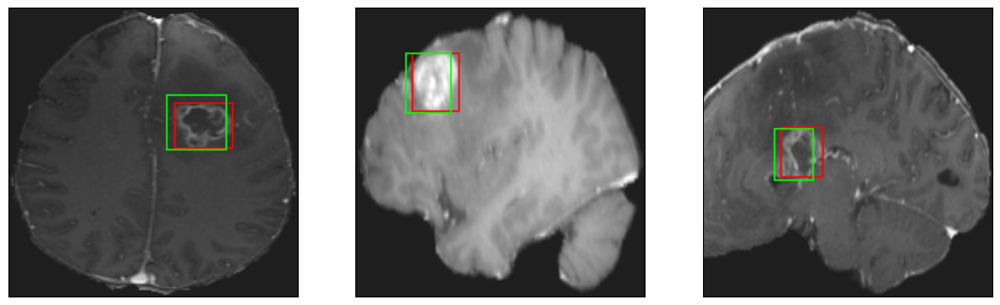

52/52 [==============================] - 7s 139ms/step - loss: 3.3539 - IoU: 0.7117 - val_loss: 4.4604 - val_IoU: 0.6358
Epoch 83/150
52/52 [==============================] - ETA: 0s - loss: 3.4156 - IoU: 0.7151
Epoch 83: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


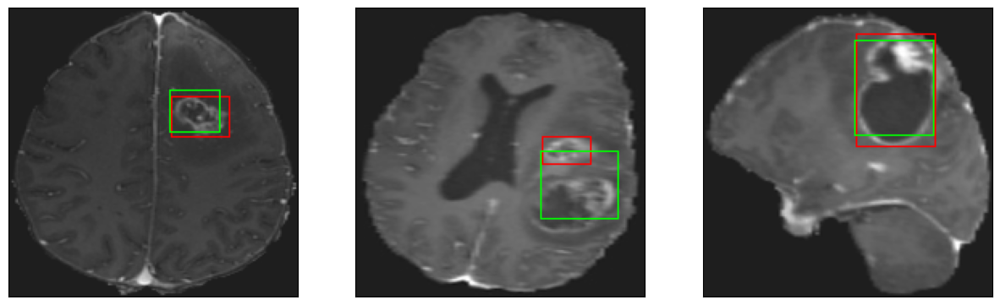

52/52 [==============================] - 7s 127ms/step - loss: 3.4156 - IoU: 0.7151 - val_loss: 4.2713 - val_IoU: 0.6773
Epoch 84/150
52/52 [==============================] - ETA: 0s - loss: 3.3022 - IoU: 0.7230
Epoch 84: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


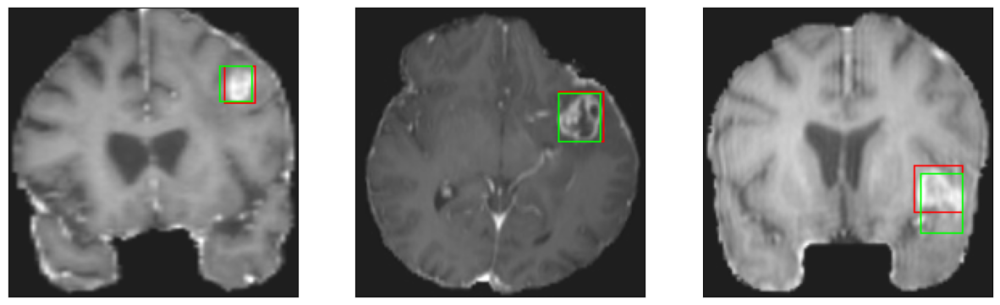

52/52 [==============================] - 7s 129ms/step - loss: 3.3022 - IoU: 0.7230 - val_loss: 4.3027 - val_IoU: 0.6824
Epoch 85/150
52/52 [==============================] - ETA: 0s - loss: 3.2021 - IoU: 0.7334
Epoch 85: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 34ms/step


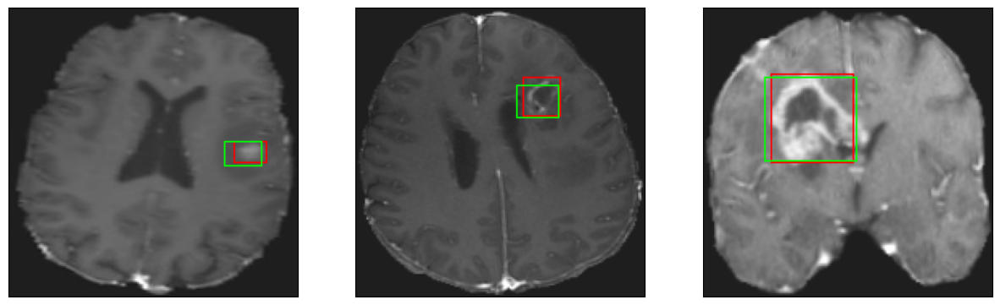

52/52 [==============================] - 8s 146ms/step - loss: 3.2021 - IoU: 0.7334 - val_loss: 4.3113 - val_IoU: 0.6522
Epoch 86/150
52/52 [==============================] - ETA: 0s - loss: 3.4006 - IoU: 0.7193
Epoch 86: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


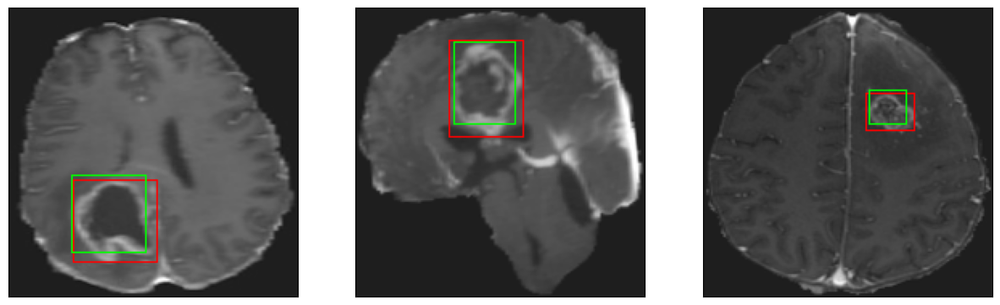

52/52 [==============================] - 7s 139ms/step - loss: 3.4006 - IoU: 0.7193 - val_loss: 5.8289 - val_IoU: 0.5892
Epoch 87/150
52/52 [==============================] - ETA: 0s - loss: 3.2315 - IoU: 0.7272
Epoch 87: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


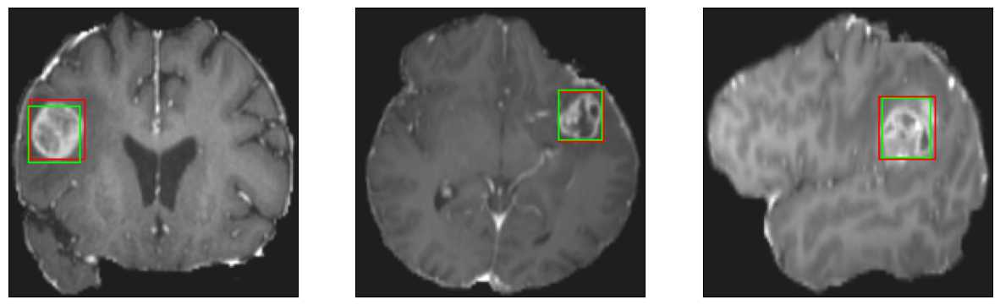

52/52 [==============================] - 7s 128ms/step - loss: 3.2315 - IoU: 0.7272 - val_loss: 4.1996 - val_IoU: 0.7132
Epoch 88/150
52/52 [==============================] - ETA: 0s - loss: 3.1196 - IoU: 0.7353
Epoch 88: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


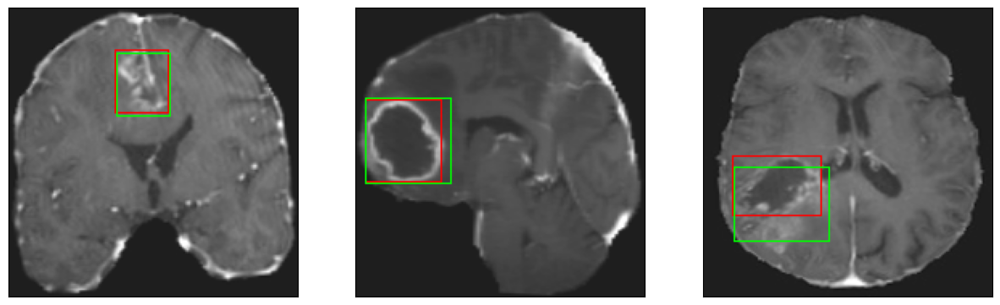

52/52 [==============================] - 6s 124ms/step - loss: 3.1196 - IoU: 0.7353 - val_loss: 4.6523 - val_IoU: 0.6737
Epoch 89/150
52/52 [==============================] - ETA: 0s - loss: 3.1036 - IoU: 0.7342
Epoch 89: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


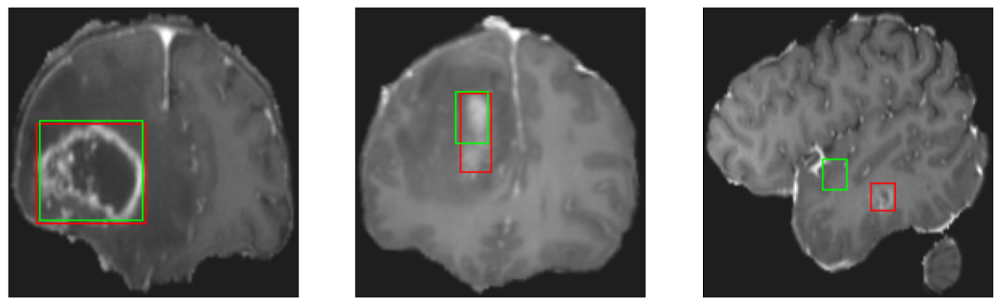

52/52 [==============================] - 7s 133ms/step - loss: 3.1036 - IoU: 0.7342 - val_loss: 4.3673 - val_IoU: 0.6727
Epoch 90/150
52/52 [==============================] - ETA: 0s - loss: 2.9029 - IoU: 0.7521
Epoch 90: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


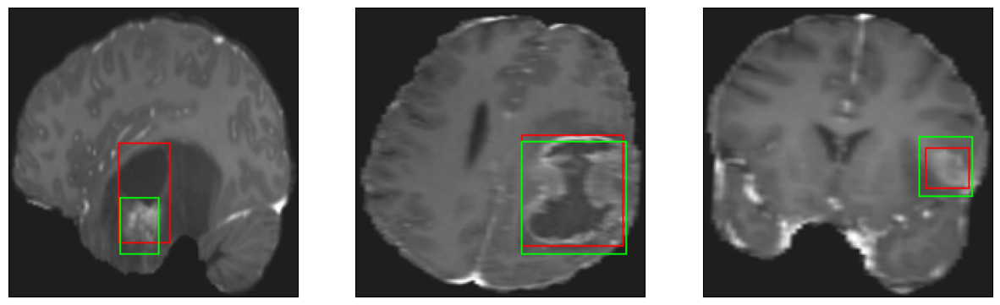

52/52 [==============================] - 7s 129ms/step - loss: 2.9029 - IoU: 0.7521 - val_loss: 4.1863 - val_IoU: 0.7126
Epoch 91/150
52/52 [==============================] - ETA: 0s - loss: 3.2095 - IoU: 0.7343
Epoch 91: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


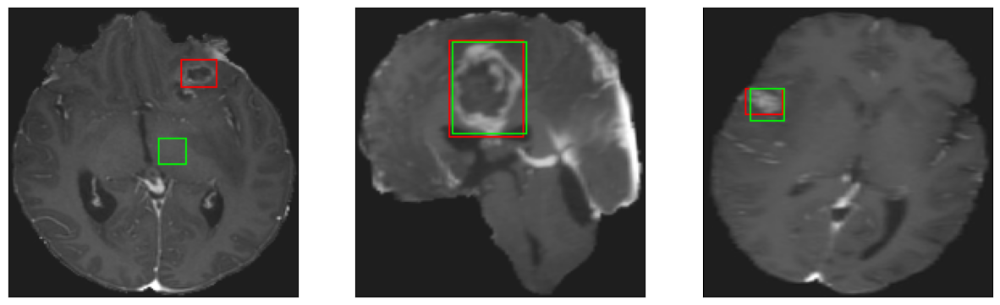

52/52 [==============================] - 6s 124ms/step - loss: 3.2095 - IoU: 0.7343 - val_loss: 4.0284 - val_IoU: 0.7064
Epoch 92/150
52/52 [==============================] - ETA: 0s - loss: 3.0447 - IoU: 0.7370
Epoch 92: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


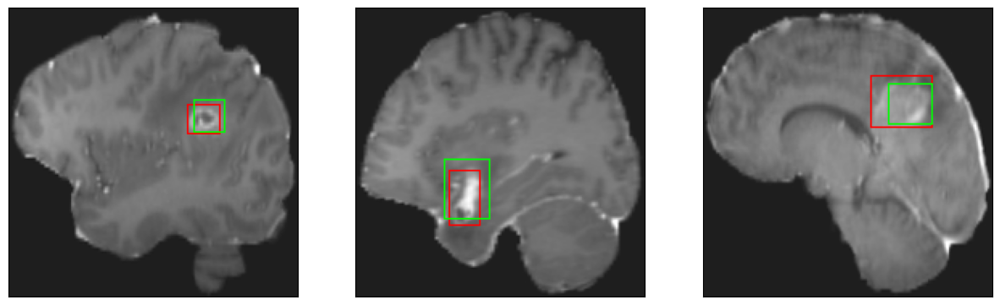

52/52 [==============================] - 7s 128ms/step - loss: 3.0447 - IoU: 0.7370 - val_loss: 4.2629 - val_IoU: 0.6751
Epoch 93/150
52/52 [==============================] - ETA: 0s - loss: 3.2014 - IoU: 0.7298
Epoch 93: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 33ms/step


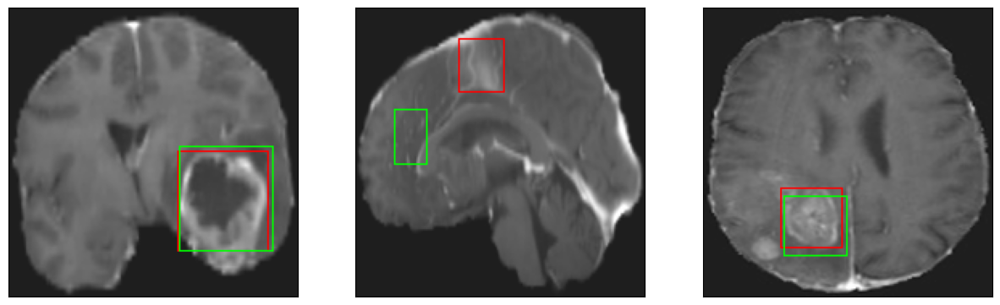

52/52 [==============================] - 7s 138ms/step - loss: 3.2014 - IoU: 0.7298 - val_loss: 4.7919 - val_IoU: 0.6808
Epoch 94/150
52/52 [==============================] - ETA: 0s - loss: 3.1993 - IoU: 0.7263
Epoch 94: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


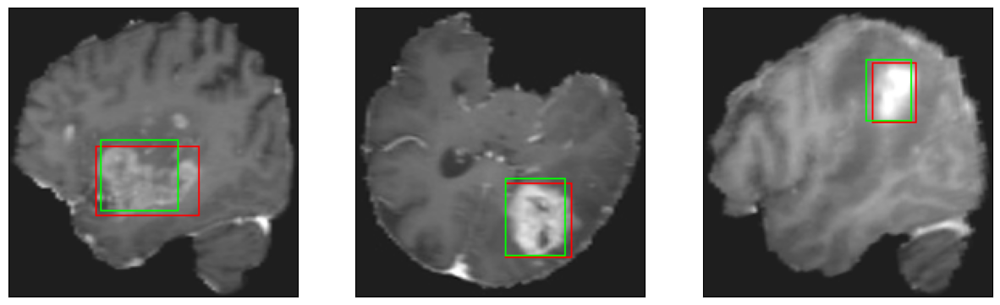

52/52 [==============================] - 7s 126ms/step - loss: 3.1993 - IoU: 0.7263 - val_loss: 4.2562 - val_IoU: 0.6963
Epoch 95/150
52/52 [==============================] - ETA: 0s - loss: 2.8244 - IoU: 0.7536
Epoch 95: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


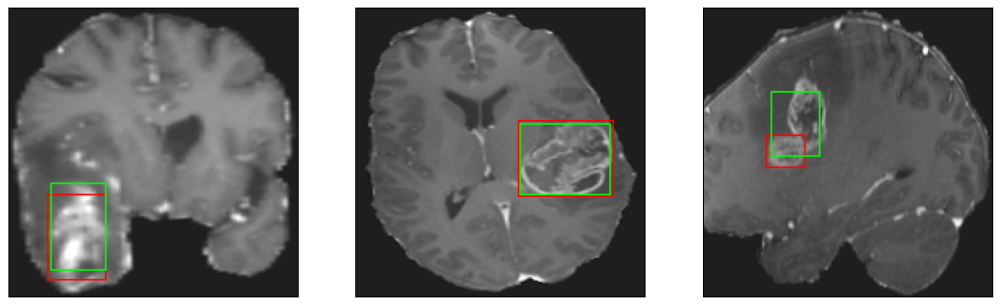

52/52 [==============================] - 7s 144ms/step - loss: 2.8244 - IoU: 0.7536 - val_loss: 4.0992 - val_IoU: 0.7199
Epoch 96/150
52/52 [==============================] - ETA: 0s - loss: 2.9499 - IoU: 0.7406
Epoch 96: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


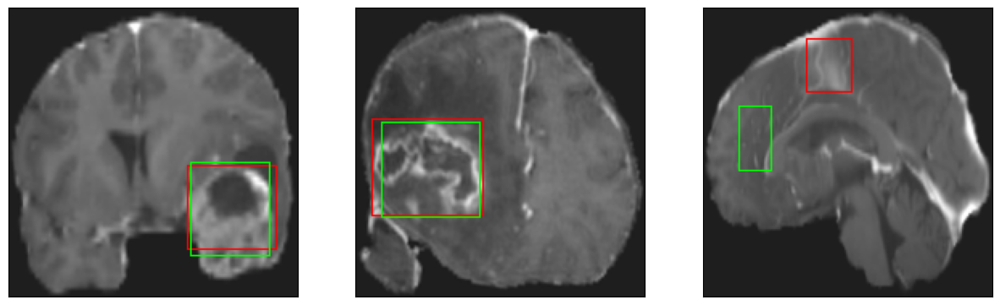

52/52 [==============================] - 7s 126ms/step - loss: 2.9499 - IoU: 0.7406 - val_loss: 4.5021 - val_IoU: 0.6861
Epoch 97/150
52/52 [==============================] - ETA: 0s - loss: 2.9403 - IoU: 0.7429
Epoch 97: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


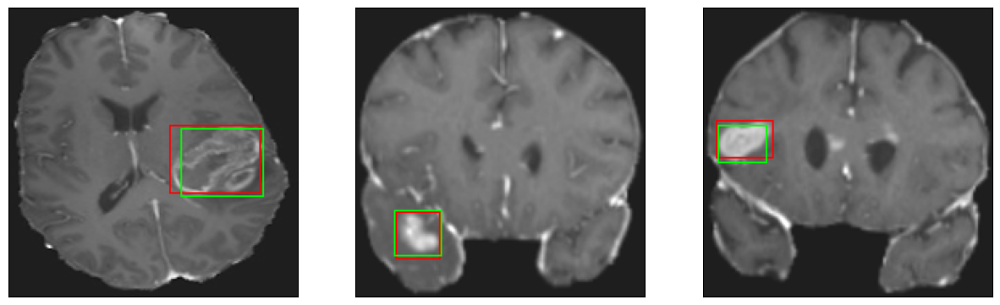

52/52 [==============================] - 7s 131ms/step - loss: 2.9403 - IoU: 0.7429 - val_loss: 4.0196 - val_IoU: 0.7173
Epoch 98/150
52/52 [==============================] - ETA: 0s - loss: 2.7698 - IoU: 0.7582
Epoch 98: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


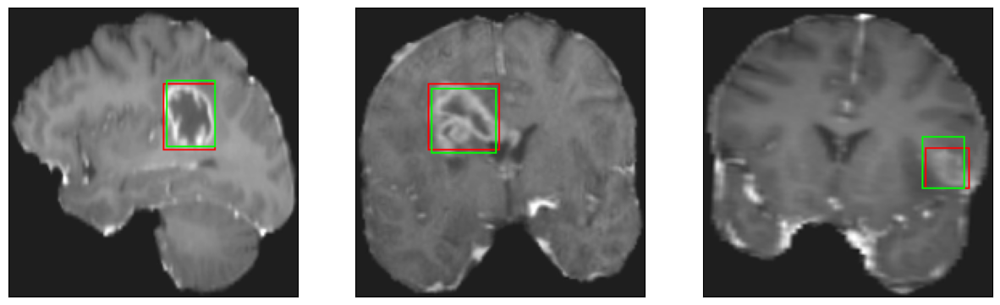

52/52 [==============================] - 7s 126ms/step - loss: 2.7698 - IoU: 0.7582 - val_loss: 4.2185 - val_IoU: 0.6969
Epoch 99/150
52/52 [==============================] - ETA: 0s - loss: 2.8069 - IoU: 0.7515
Epoch 99: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


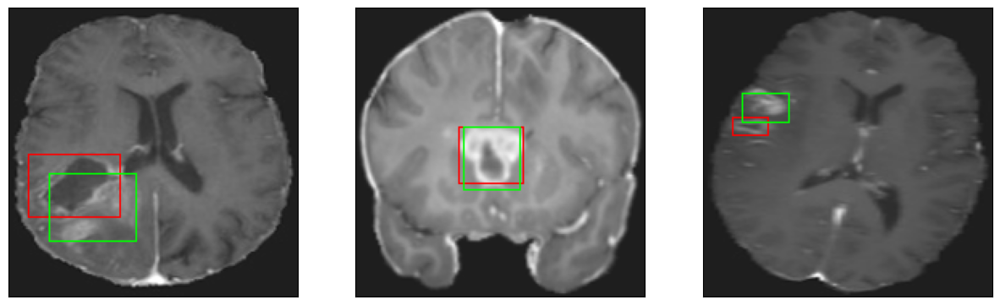

52/52 [==============================] - 7s 142ms/step - loss: 2.8069 - IoU: 0.7515 - val_loss: 4.3169 - val_IoU: 0.6977
Epoch 100/150
52/52 [==============================] - ETA: 0s - loss: 2.7890 - IoU: 0.7605
Epoch 100: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


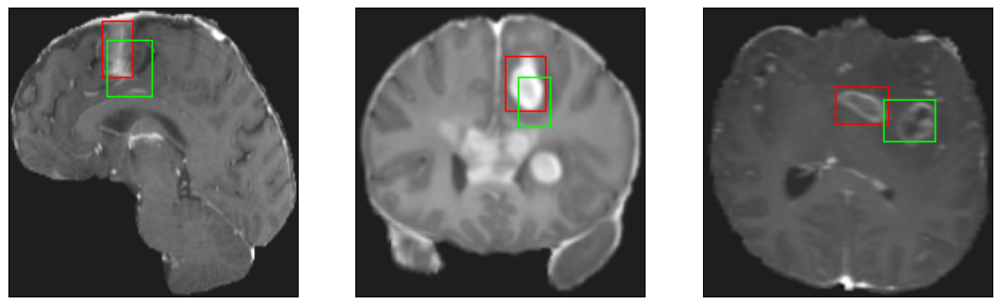

52/52 [==============================] - 7s 127ms/step - loss: 2.7890 - IoU: 0.7605 - val_loss: 3.9925 - val_IoU: 0.7108
Epoch 101/150
52/52 [==============================] - ETA: 0s - loss: 2.9007 - IoU: 0.7459
Epoch 101: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


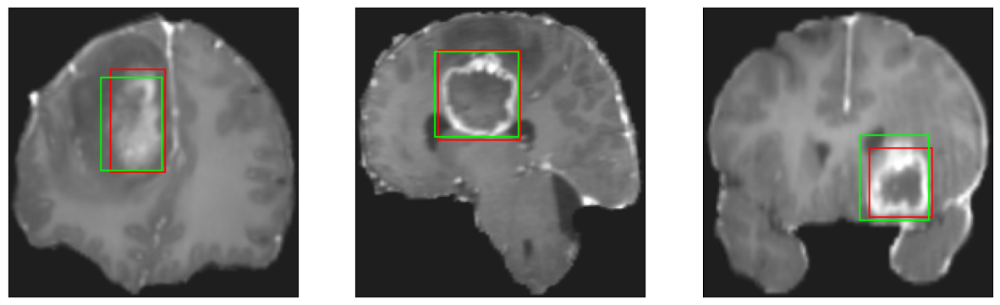

52/52 [==============================] - 7s 140ms/step - loss: 2.9007 - IoU: 0.7459 - val_loss: 4.3604 - val_IoU: 0.6960
Epoch 102/150
52/52 [==============================] - ETA: 0s - loss: 2.8989 - IoU: 0.7546
Epoch 102: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


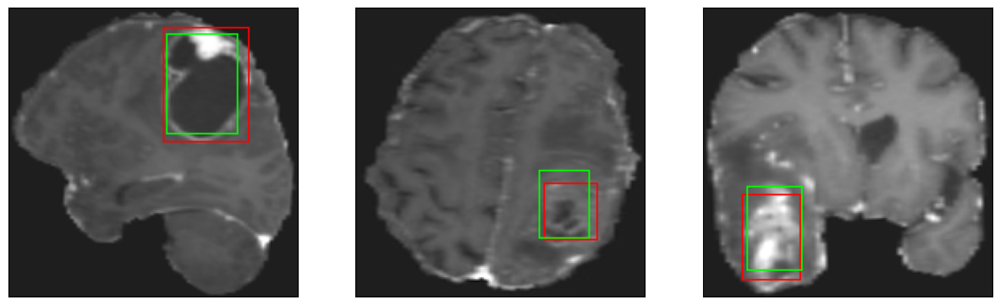

52/52 [==============================] - 6s 124ms/step - loss: 2.8989 - IoU: 0.7546 - val_loss: 4.3885 - val_IoU: 0.6632
Epoch 103/150
52/52 [==============================] - ETA: 0s - loss: 2.8304 - IoU: 0.7567
Epoch 103: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


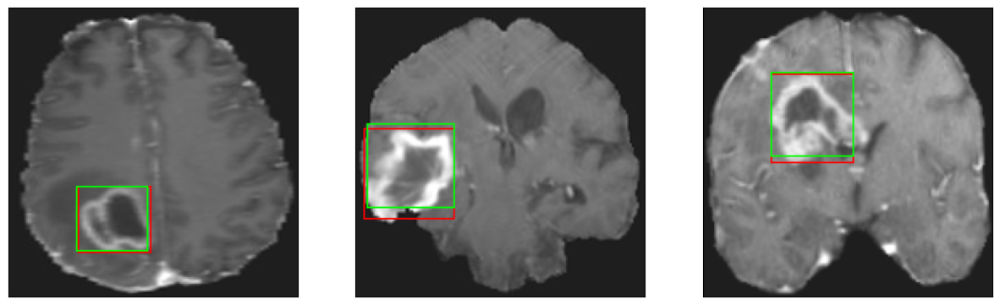

52/52 [==============================] - 7s 130ms/step - loss: 2.8304 - IoU: 0.7567 - val_loss: 4.1889 - val_IoU: 0.7003
Epoch 104/150
52/52 [==============================] - ETA: 0s - loss: 2.7643 - IoU: 0.7647
Epoch 104: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 34ms/step


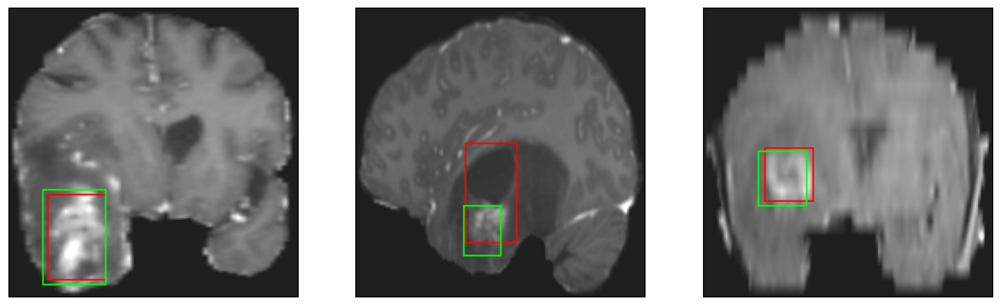

52/52 [==============================] - 7s 133ms/step - loss: 2.7643 - IoU: 0.7647 - val_loss: 4.8032 - val_IoU: 0.6373
Epoch 105/150
52/52 [==============================] - ETA: 0s - loss: 2.7671 - IoU: 0.7544
Epoch 105: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


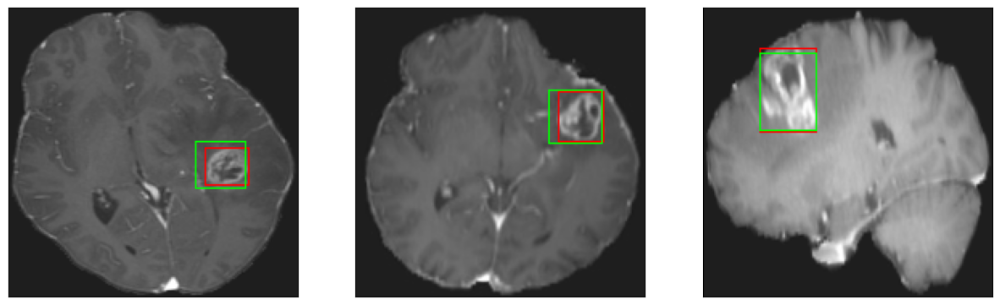

52/52 [==============================] - 6s 123ms/step - loss: 2.7671 - IoU: 0.7544 - val_loss: 4.4150 - val_IoU: 0.6649
Epoch 106/150
52/52 [==============================] - ETA: 0s - loss: 2.8873 - IoU: 0.7521
Epoch 106: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


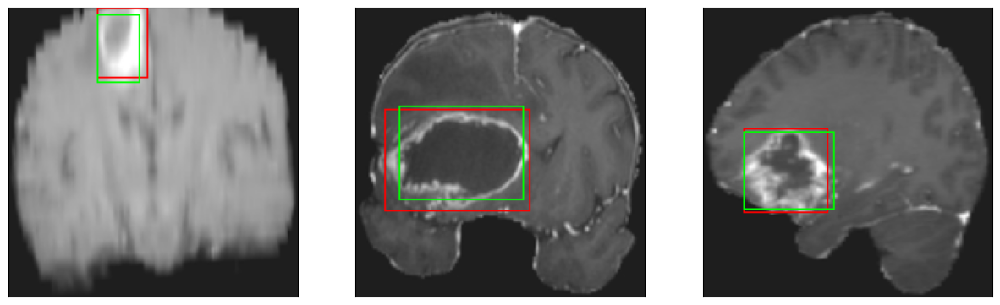

52/52 [==============================] - 8s 146ms/step - loss: 2.8873 - IoU: 0.7521 - val_loss: 3.9821 - val_IoU: 0.6857
Epoch 107/150
52/52 [==============================] - ETA: 0s - loss: 2.7050 - IoU: 0.7535
Epoch 107: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


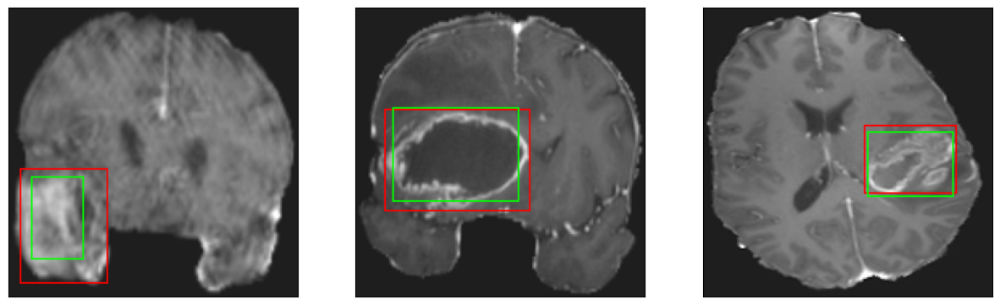

52/52 [==============================] - 6s 123ms/step - loss: 2.7050 - IoU: 0.7535 - val_loss: 4.1836 - val_IoU: 0.6890
Epoch 108/150
52/52 [==============================] - ETA: 0s - loss: 2.7639 - IoU: 0.7484
Epoch 108: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


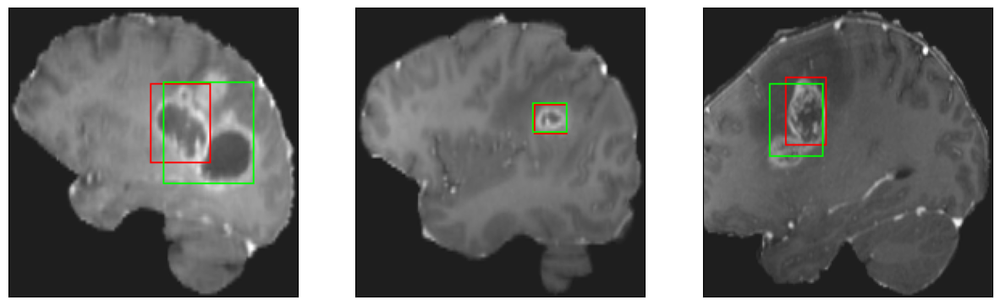

52/52 [==============================] - 7s 142ms/step - loss: 2.7639 - IoU: 0.7484 - val_loss: 4.3090 - val_IoU: 0.6709
Epoch 109/150
52/52 [==============================] - ETA: 0s - loss: 2.7668 - IoU: 0.7522
Epoch 109: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


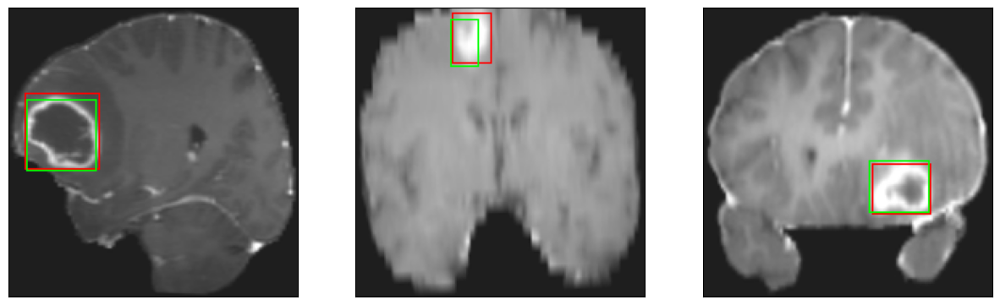

52/52 [==============================] - 6s 124ms/step - loss: 2.7668 - IoU: 0.7522 - val_loss: 4.0379 - val_IoU: 0.7057
Epoch 110/150
52/52 [==============================] - ETA: 0s - loss: 2.5745 - IoU: 0.7674
Epoch 110: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


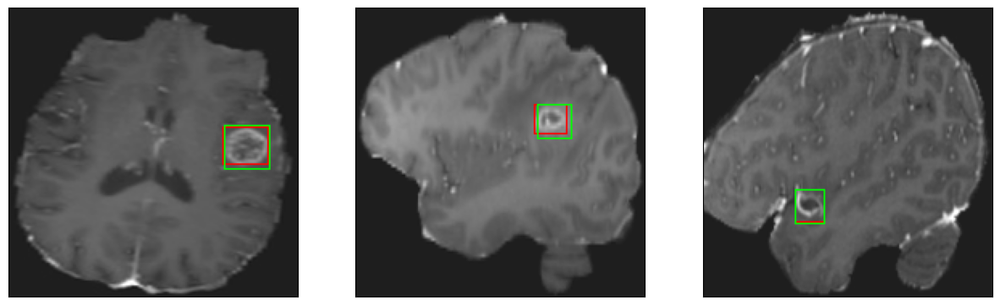

52/52 [==============================] - 8s 152ms/step - loss: 2.5745 - IoU: 0.7674 - val_loss: 3.8953 - val_IoU: 0.7194
Epoch 111/150
52/52 [==============================] - ETA: 0s - loss: 2.7300 - IoU: 0.7540
Epoch 111: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


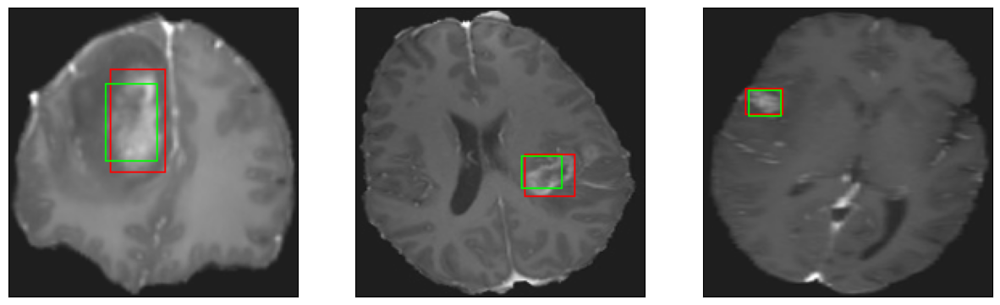

52/52 [==============================] - 7s 144ms/step - loss: 2.7300 - IoU: 0.7540 - val_loss: 5.1416 - val_IoU: 0.6377
Epoch 112/150
52/52 [==============================] - ETA: 0s - loss: 2.9094 - IoU: 0.7447
Epoch 112: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


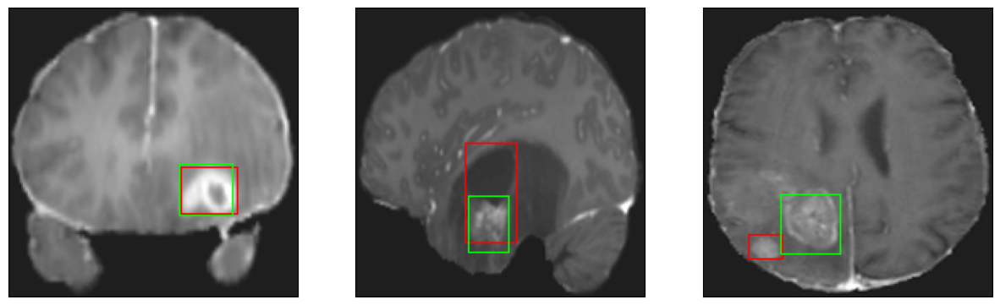

52/52 [==============================] - 7s 129ms/step - loss: 2.9094 - IoU: 0.7447 - val_loss: 4.1954 - val_IoU: 0.6870
Epoch 113/150
52/52 [==============================] - ETA: 0s - loss: 2.6425 - IoU: 0.7688
Epoch 113: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


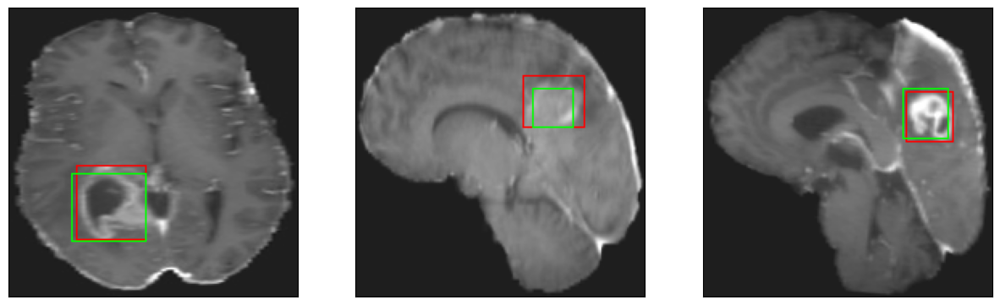

52/52 [==============================] - 7s 139ms/step - loss: 2.6425 - IoU: 0.7688 - val_loss: 4.4716 - val_IoU: 0.6576
Epoch 114/150
52/52 [==============================] - ETA: 0s - loss: 2.7489 - IoU: 0.7480
Epoch 114: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


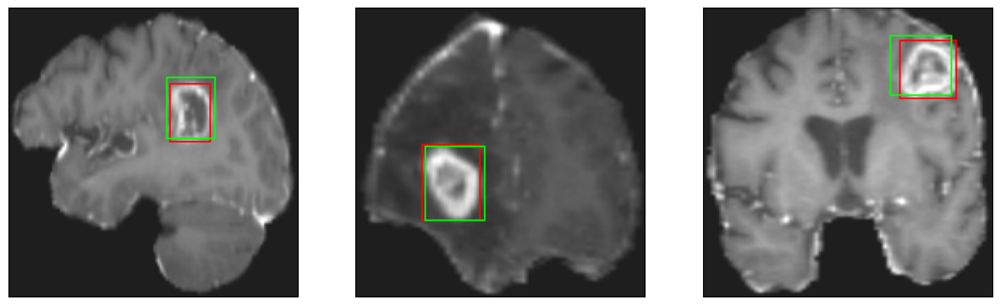

52/52 [==============================] - 7s 128ms/step - loss: 2.7489 - IoU: 0.7480 - val_loss: 3.7918 - val_IoU: 0.7066
Epoch 115/150
52/52 [==============================] - ETA: 0s - loss: 2.8701 - IoU: 0.7300
Epoch 115: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


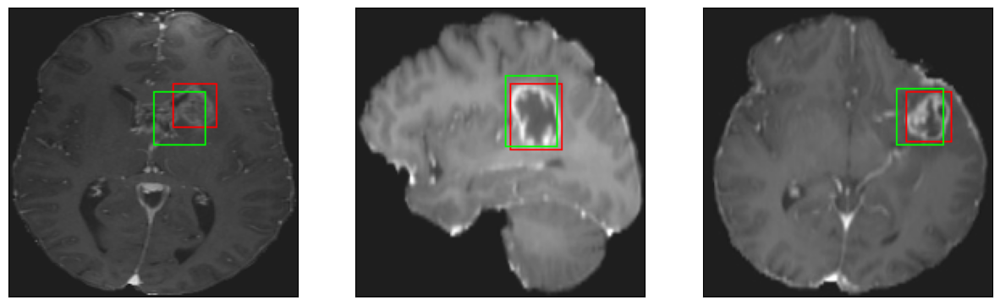

52/52 [==============================] - 7s 131ms/step - loss: 2.8701 - IoU: 0.7300 - val_loss: 4.7578 - val_IoU: 0.6446
Epoch 116/150
52/52 [==============================] - ETA: 0s - loss: 2.7281 - IoU: 0.7520
Epoch 116: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


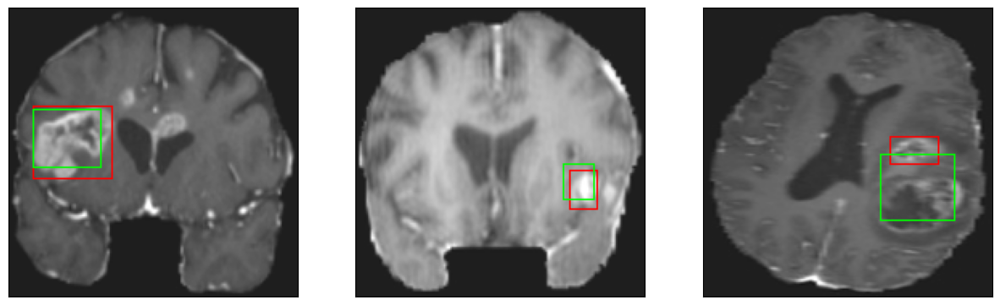

52/52 [==============================] - 7s 138ms/step - loss: 2.7281 - IoU: 0.7520 - val_loss: 5.3126 - val_IoU: 0.5841
Epoch 117/150
52/52 [==============================] - ETA: 0s - loss: 2.6863 - IoU: 0.7613
Epoch 117: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


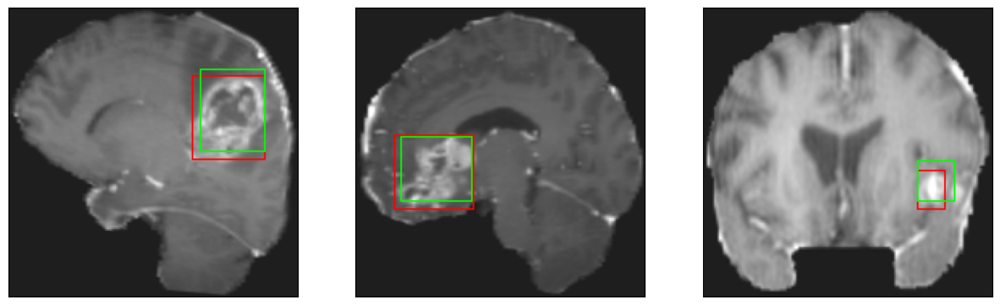

52/52 [==============================] - 7s 126ms/step - loss: 2.6863 - IoU: 0.7613 - val_loss: 4.0536 - val_IoU: 0.7075
Epoch 118/150
52/52 [==============================] - ETA: 0s - loss: 2.8053 - IoU: 0.7535
Epoch 118: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


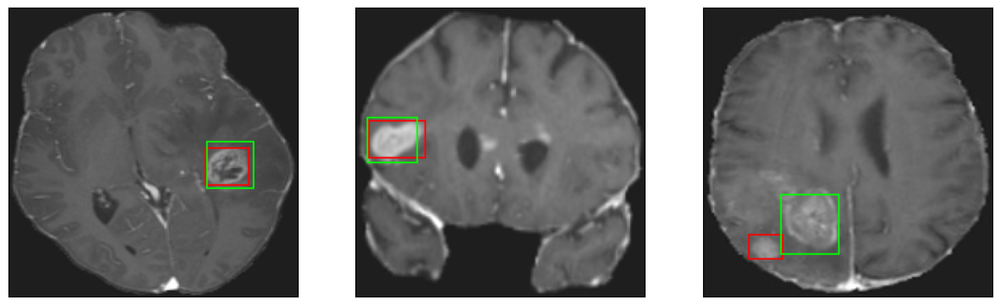

52/52 [==============================] - 7s 137ms/step - loss: 2.8053 - IoU: 0.7535 - val_loss: 4.2043 - val_IoU: 0.7191
Epoch 119/150
52/52 [==============================] - ETA: 0s - loss: 2.7132 - IoU: 0.7472
Epoch 119: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


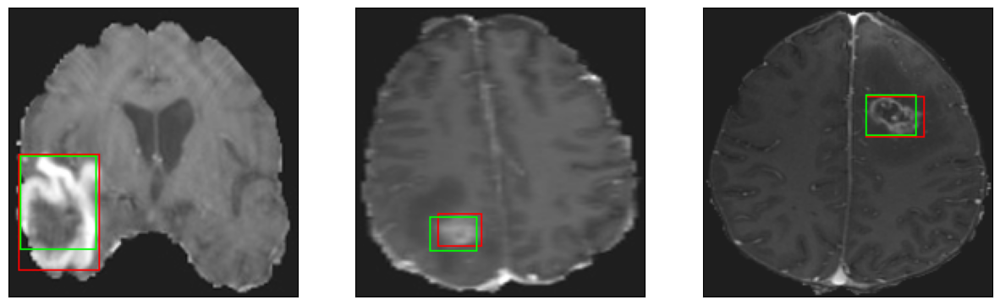

52/52 [==============================] - 7s 129ms/step - loss: 2.7132 - IoU: 0.7472 - val_loss: 4.4177 - val_IoU: 0.6970
Epoch 120/150
52/52 [==============================] - ETA: 0s - loss: 2.8852 - IoU: 0.7433
Epoch 120: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


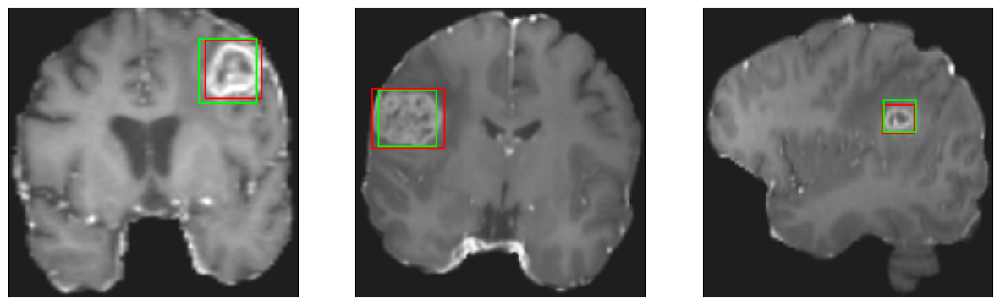

52/52 [==============================] - 7s 126ms/step - loss: 2.8852 - IoU: 0.7433 - val_loss: 4.1801 - val_IoU: 0.6873
Epoch 121/150
52/52 [==============================] - ETA: 0s - loss: 2.5414 - IoU: 0.7715
Epoch 121: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


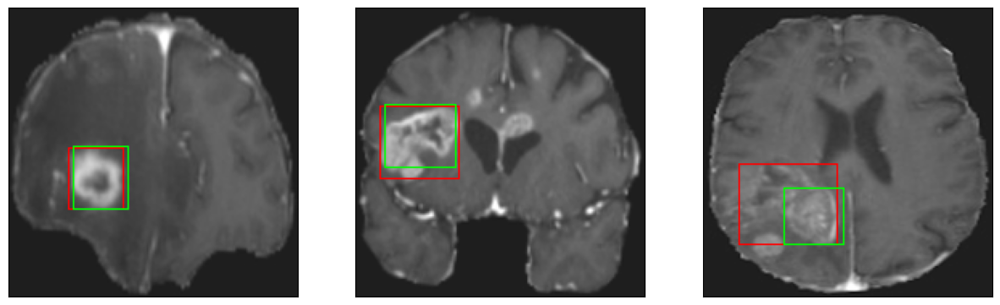

52/52 [==============================] - 7s 138ms/step - loss: 2.5414 - IoU: 0.7715 - val_loss: 4.4627 - val_IoU: 0.6742
Epoch 122/150
52/52 [==============================] - ETA: 0s - loss: 2.4783 - IoU: 0.7697
Epoch 122: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 35ms/step


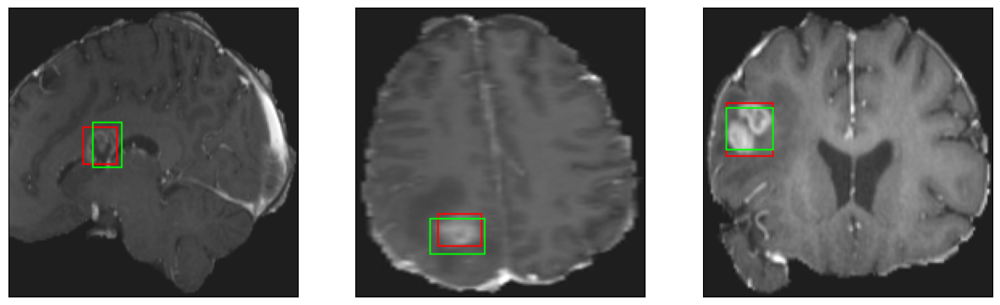

52/52 [==============================] - 7s 126ms/step - loss: 2.4783 - IoU: 0.7697 - val_loss: 4.1655 - val_IoU: 0.7146
Epoch 123/150
52/52 [==============================] - ETA: 0s - loss: 2.4664 - IoU: 0.7779
Epoch 123: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


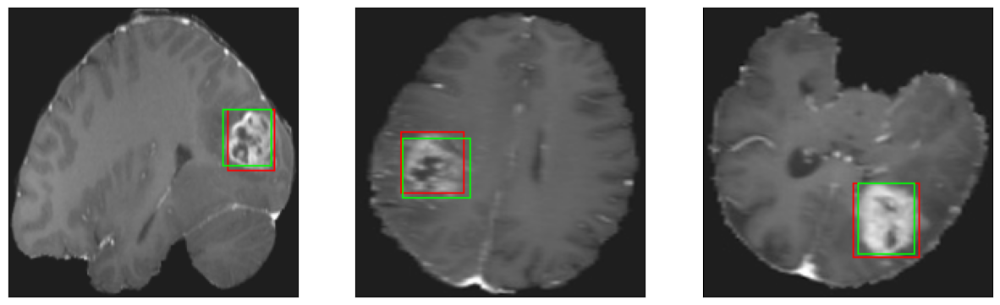

52/52 [==============================] - 7s 141ms/step - loss: 2.4664 - IoU: 0.7779 - val_loss: 3.9227 - val_IoU: 0.7166
Epoch 124/150
52/52 [==============================] - ETA: 0s - loss: 2.5980 - IoU: 0.7714
Epoch 124: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


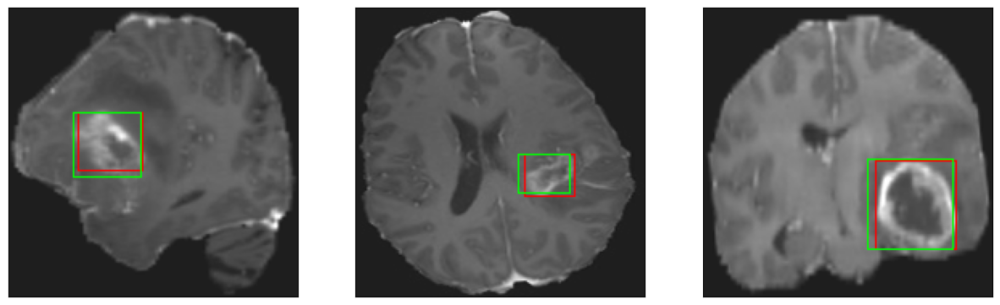

52/52 [==============================] - 6s 119ms/step - loss: 2.5980 - IoU: 0.7714 - val_loss: 4.2975 - val_IoU: 0.6910
Epoch 125/150
52/52 [==============================] - ETA: 0s - loss: 2.5328 - IoU: 0.7714
Epoch 125: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


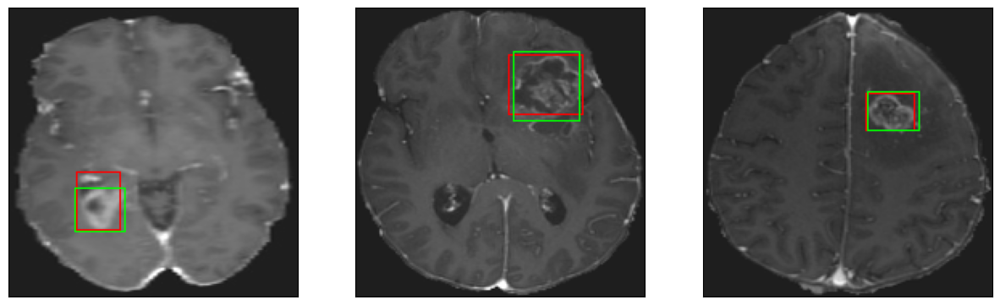

52/52 [==============================] - 7s 139ms/step - loss: 2.5328 - IoU: 0.7714 - val_loss: 4.1210 - val_IoU: 0.7081
Epoch 126/150
52/52 [==============================] - ETA: 0s - loss: 2.5046 - IoU: 0.7775
Epoch 126: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


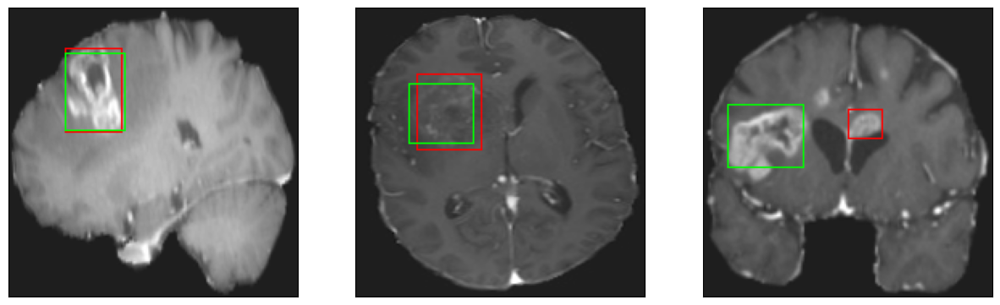

52/52 [==============================] - 7s 130ms/step - loss: 2.5046 - IoU: 0.7775 - val_loss: 4.0852 - val_IoU: 0.6755
Epoch 127/150
52/52 [==============================] - ETA: 0s - loss: 2.5744 - IoU: 0.7660
Epoch 127: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 32ms/step


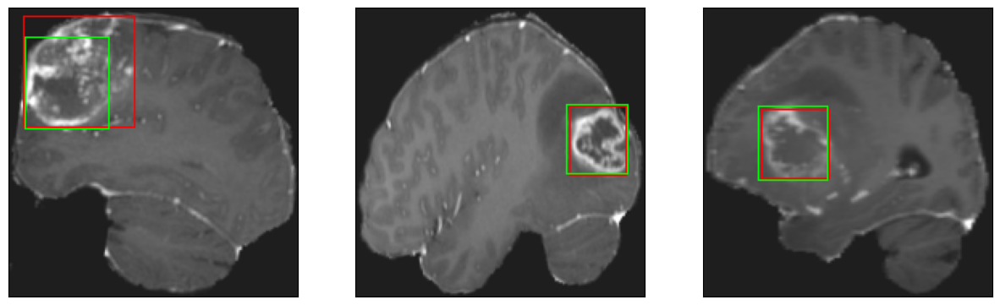

52/52 [==============================] - 7s 135ms/step - loss: 2.5744 - IoU: 0.7660 - val_loss: 3.7961 - val_IoU: 0.6996
Epoch 128/150
52/52 [==============================] - ETA: 0s - loss: 2.4364 - IoU: 0.7794
Epoch 128: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


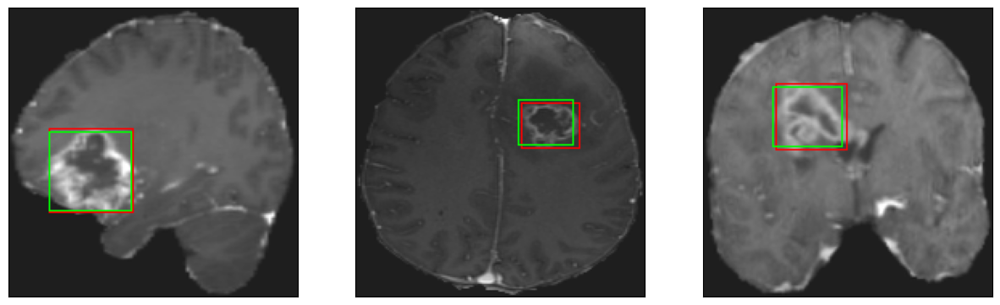

52/52 [==============================] - 7s 130ms/step - loss: 2.4364 - IoU: 0.7794 - val_loss: 4.0823 - val_IoU: 0.6903
Epoch 129/150
52/52 [==============================] - ETA: 0s - loss: 2.6117 - IoU: 0.7614
Epoch 129: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


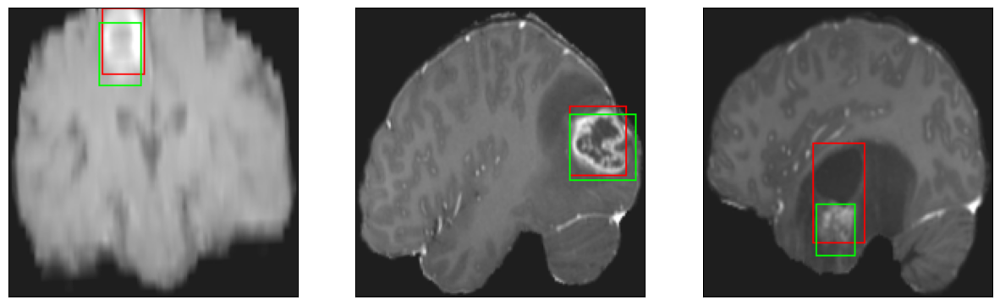

52/52 [==============================] - 7s 131ms/step - loss: 2.6117 - IoU: 0.7614 - val_loss: 4.0326 - val_IoU: 0.6657
Epoch 130/150
52/52 [==============================] - ETA: 0s - loss: 2.5834 - IoU: 0.7664
Epoch 130: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


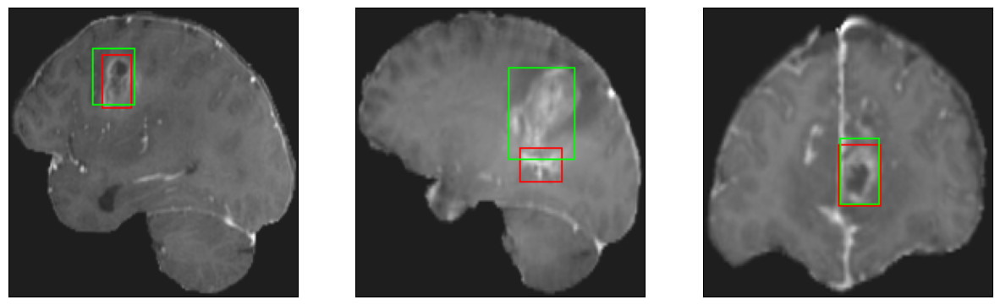

52/52 [==============================] - 7s 129ms/step - loss: 2.5834 - IoU: 0.7664 - val_loss: 4.4242 - val_IoU: 0.6725
Epoch 131/150
52/52 [==============================] - ETA: 0s - loss: 2.6529 - IoU: 0.7556
Epoch 131: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


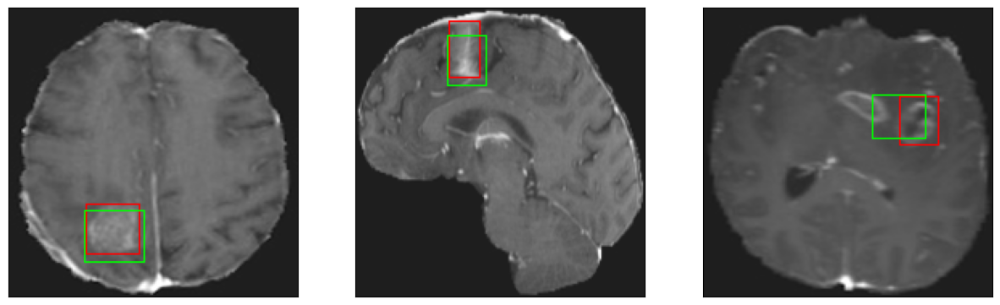

52/52 [==============================] - 7s 135ms/step - loss: 2.6529 - IoU: 0.7556 - val_loss: 3.9168 - val_IoU: 0.7192
Epoch 132/150
52/52 [==============================] - ETA: 0s - loss: 2.4852 - IoU: 0.7781
Epoch 132: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 35ms/step


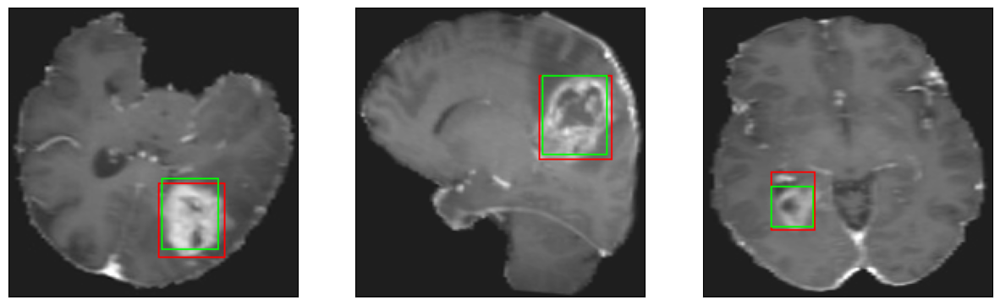

52/52 [==============================] - 7s 140ms/step - loss: 2.4852 - IoU: 0.7781 - val_loss: 4.5760 - val_IoU: 0.6757
Epoch 133/150
52/52 [==============================] - ETA: 0s - loss: 2.5731 - IoU: 0.7760
Epoch 133: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


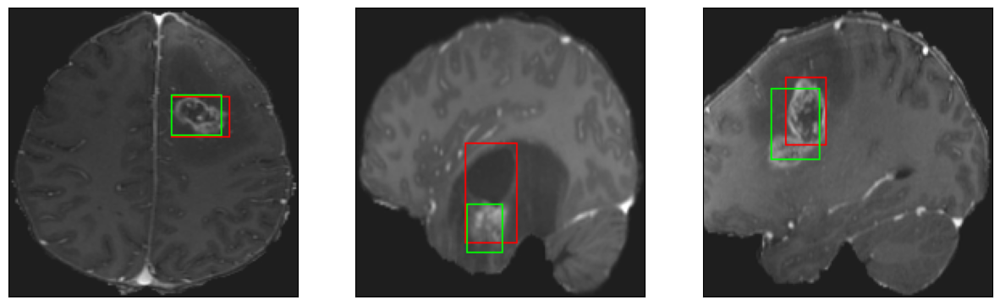

52/52 [==============================] - 7s 126ms/step - loss: 2.5731 - IoU: 0.7760 - val_loss: 3.8798 - val_IoU: 0.7150
Epoch 134/150
52/52 [==============================] - ETA: 0s - loss: 2.3829 - IoU: 0.7863
Epoch 134: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


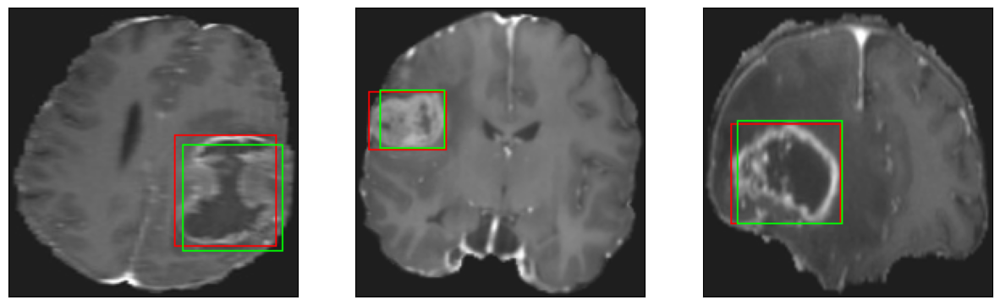

52/52 [==============================] - 7s 127ms/step - loss: 2.3829 - IoU: 0.7863 - val_loss: 3.9577 - val_IoU: 0.6970
Epoch 135/150
52/52 [==============================] - ETA: 0s - loss: 2.5033 - IoU: 0.7734
Epoch 135: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 31ms/step


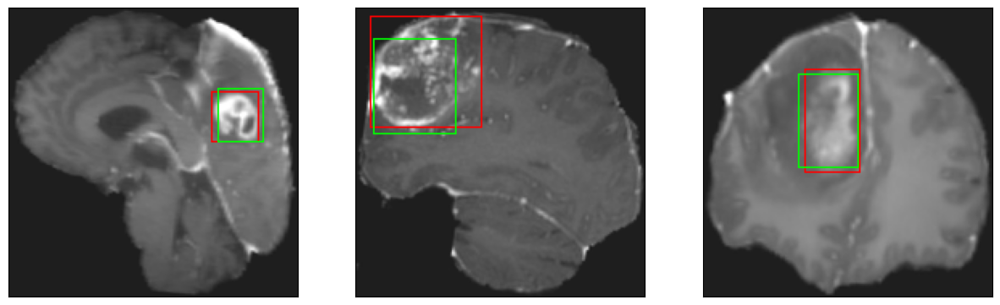

52/52 [==============================] - 7s 130ms/step - loss: 2.5033 - IoU: 0.7734 - val_loss: 3.7963 - val_IoU: 0.7179
Epoch 136/150
52/52 [==============================] - ETA: 0s - loss: 2.3586 - IoU: 0.7838
Epoch 136: val_loss did not improve from 3.76656
8/8 [==============================] - 0s 30ms/step


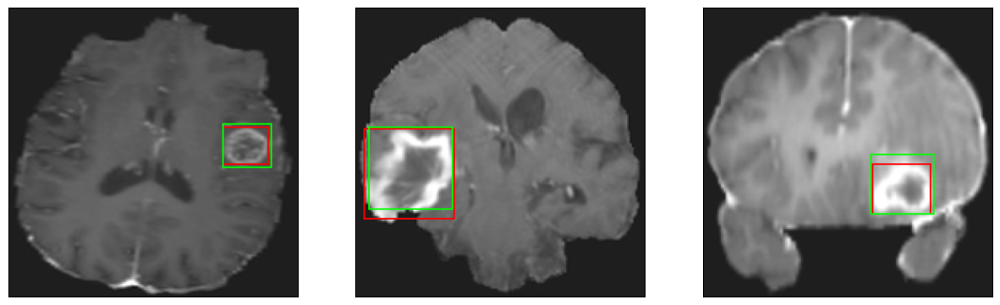

52/52 [==============================] - 7s 134ms/step - loss: 2.3586 - IoU: 0.7838 - val_loss: 3.9636 - val_IoU: 0.7392
Epoch 137/150
52/52 [==============================] - ETA: 0s - loss: 2.3589 - IoU: 0.7864
Epoch 137: val_loss improved from 3.76656 to 3.72847, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


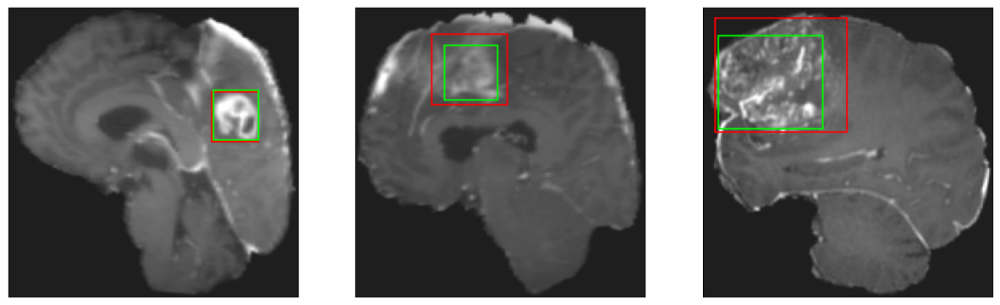

52/52 [==============================] - 10s 186ms/step - loss: 2.3589 - IoU: 0.7864 - val_loss: 3.7285 - val_IoU: 0.7373
Epoch 138/150
52/52 [==============================] - ETA: 0s - loss: 2.3374 - IoU: 0.7869
Epoch 138: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 31ms/step


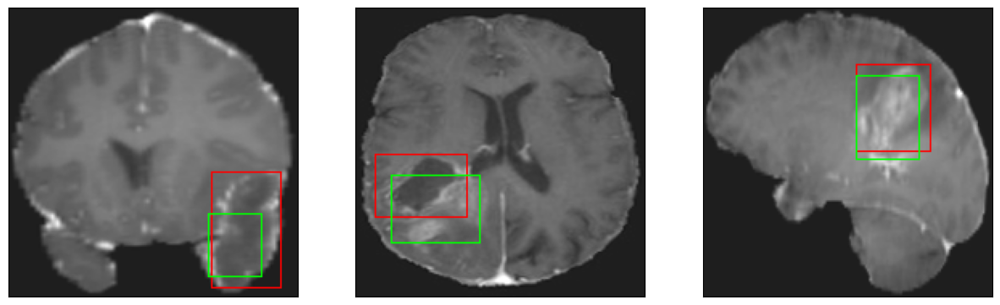

52/52 [==============================] - 7s 133ms/step - loss: 2.3374 - IoU: 0.7869 - val_loss: 4.3154 - val_IoU: 0.6898
Epoch 139/150
52/52 [==============================] - ETA: 0s - loss: 2.3973 - IoU: 0.7871
Epoch 139: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 33ms/step


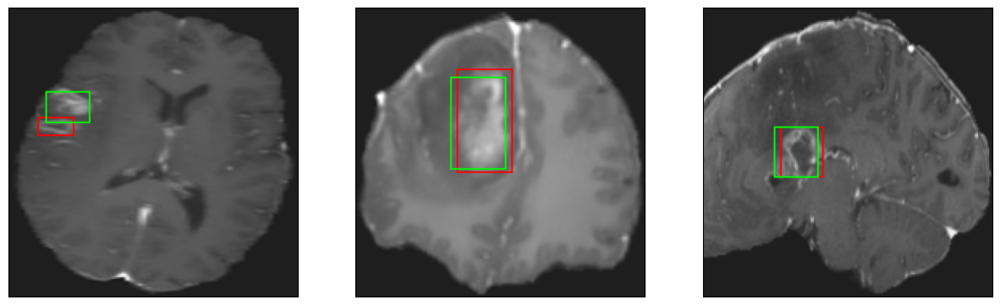

52/52 [==============================] - 7s 134ms/step - loss: 2.3973 - IoU: 0.7871 - val_loss: 4.0952 - val_IoU: 0.7071
Epoch 140/150
52/52 [==============================] - ETA: 0s - loss: 2.3160 - IoU: 0.7908
Epoch 140: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 31ms/step


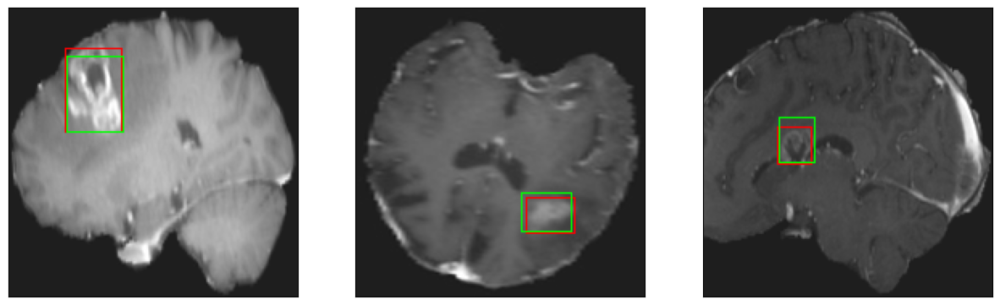

52/52 [==============================] - 7s 142ms/step - loss: 2.3160 - IoU: 0.7908 - val_loss: 3.9702 - val_IoU: 0.7070
Epoch 141/150
52/52 [==============================] - ETA: 0s - loss: 2.4850 - IoU: 0.7782
Epoch 141: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 33ms/step


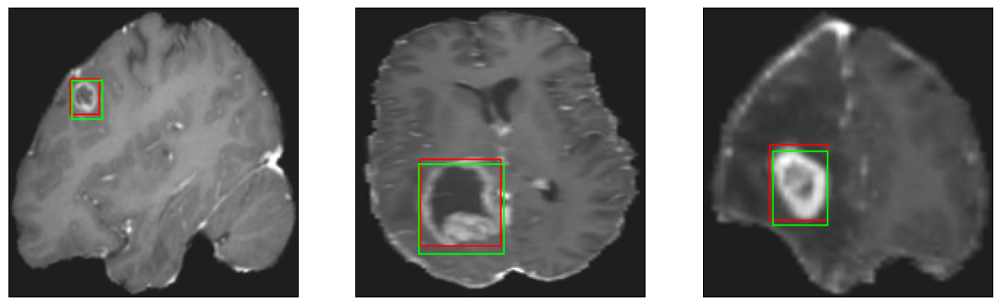

52/52 [==============================] - 7s 130ms/step - loss: 2.4850 - IoU: 0.7782 - val_loss: 3.8220 - val_IoU: 0.7124
Epoch 142/150
52/52 [==============================] - ETA: 0s - loss: 2.3104 - IoU: 0.7936
Epoch 142: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 31ms/step


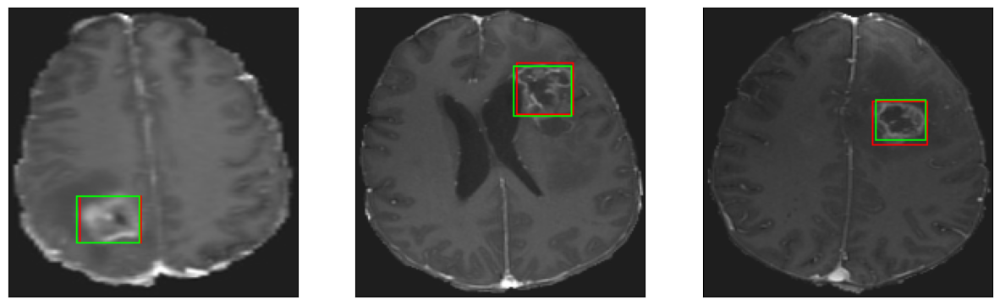

52/52 [==============================] - 7s 132ms/step - loss: 2.3104 - IoU: 0.7936 - val_loss: 3.9154 - val_IoU: 0.7164
Epoch 143/150
52/52 [==============================] - ETA: 0s - loss: 2.4357 - IoU: 0.7794
Epoch 143: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 32ms/step


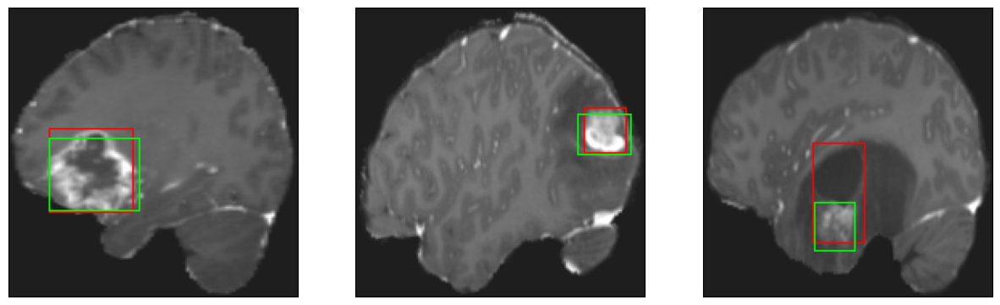

52/52 [==============================] - 6s 122ms/step - loss: 2.4357 - IoU: 0.7794 - val_loss: 4.2196 - val_IoU: 0.6979
Epoch 144/150
52/52 [==============================] - ETA: 0s - loss: 2.4400 - IoU: 0.7829
Epoch 144: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 30ms/step


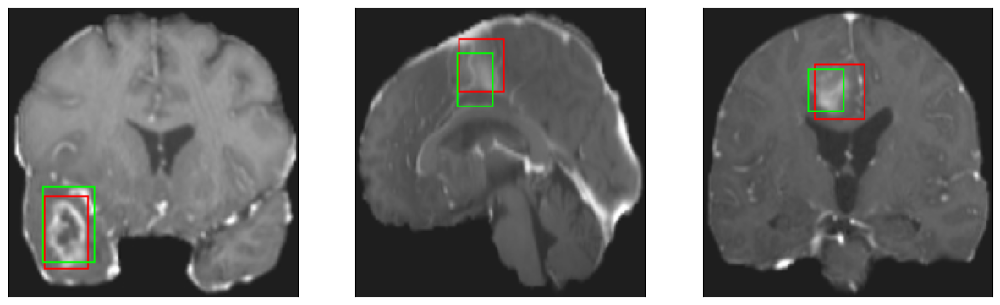

52/52 [==============================] - 6s 123ms/step - loss: 2.4400 - IoU: 0.7829 - val_loss: 4.5815 - val_IoU: 0.6501
Epoch 145/150
52/52 [==============================] - ETA: 0s - loss: 2.3613 - IoU: 0.7847
Epoch 145: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 31ms/step


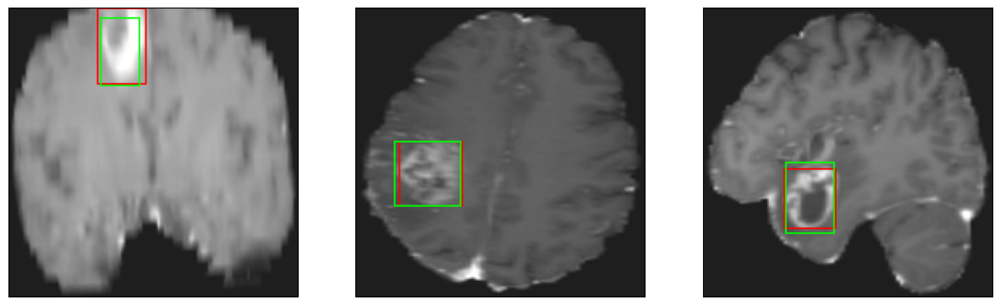

52/52 [==============================] - 7s 140ms/step - loss: 2.3613 - IoU: 0.7847 - val_loss: 3.9765 - val_IoU: 0.7237
Epoch 146/150
52/52 [==============================] - ETA: 0s - loss: 2.3754 - IoU: 0.7856
Epoch 146: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 32ms/step


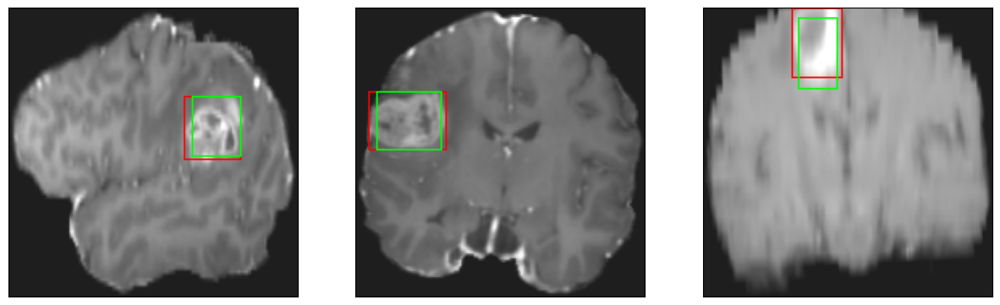

52/52 [==============================] - 7s 140ms/step - loss: 2.3754 - IoU: 0.7856 - val_loss: 4.0462 - val_IoU: 0.7233
Epoch 147/150
52/52 [==============================] - ETA: 0s - loss: 3.1546 - IoU: 0.7285
Epoch 147: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 31ms/step


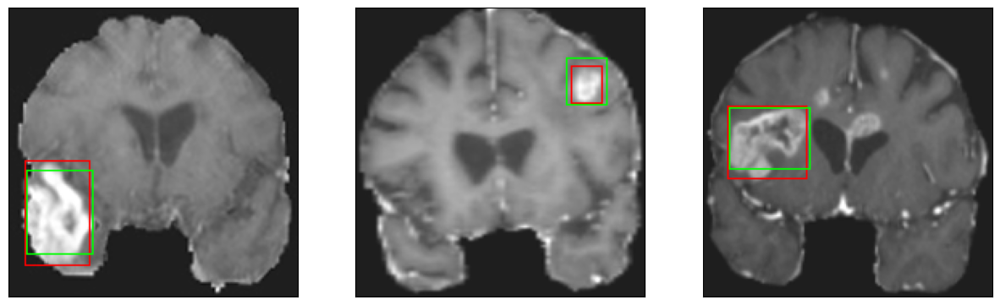

52/52 [==============================] - 7s 143ms/step - loss: 3.1546 - IoU: 0.7285 - val_loss: 4.4358 - val_IoU: 0.7114
Epoch 148/150
52/52 [==============================] - ETA: 0s - loss: 2.7182 - IoU: 0.7612
Epoch 148: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 32ms/step


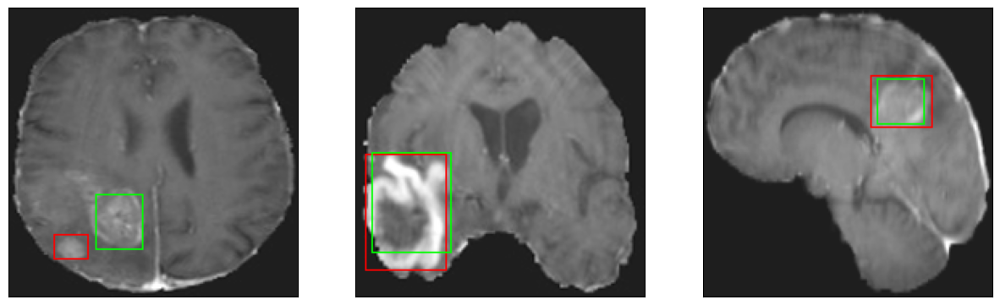

52/52 [==============================] - 7s 126ms/step - loss: 2.7182 - IoU: 0.7612 - val_loss: 4.8652 - val_IoU: 0.6885
Epoch 149/150
52/52 [==============================] - ETA: 0s - loss: 2.6691 - IoU: 0.7636
Epoch 149: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 30ms/step


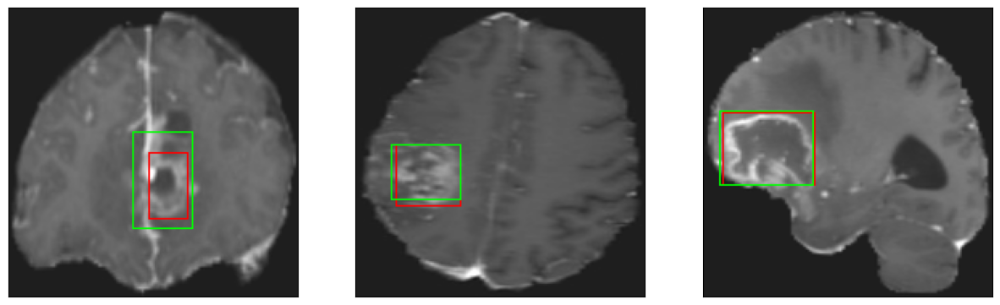

52/52 [==============================] - 6s 122ms/step - loss: 2.6691 - IoU: 0.7636 - val_loss: 4.6545 - val_IoU: 0.7270
Epoch 150/150
52/52 [==============================] - ETA: 0s - loss: 2.4957 - IoU: 0.7771
Epoch 150: val_loss did not improve from 3.72847
8/8 [==============================] - 0s 30ms/step


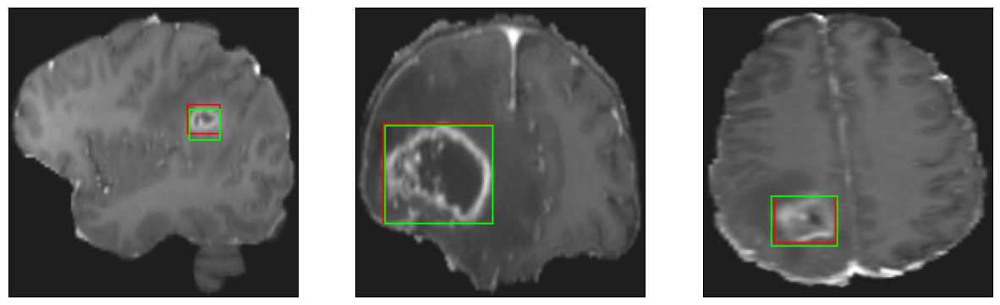

52/52 [==============================] - 8s 145ms/step - loss: 2.4957 - IoU: 0.7771 - val_loss: 4.3814 - val_IoU: 0.6935


In [26]:
hist = model.fit(
        train_dataset,
        epochs=150,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

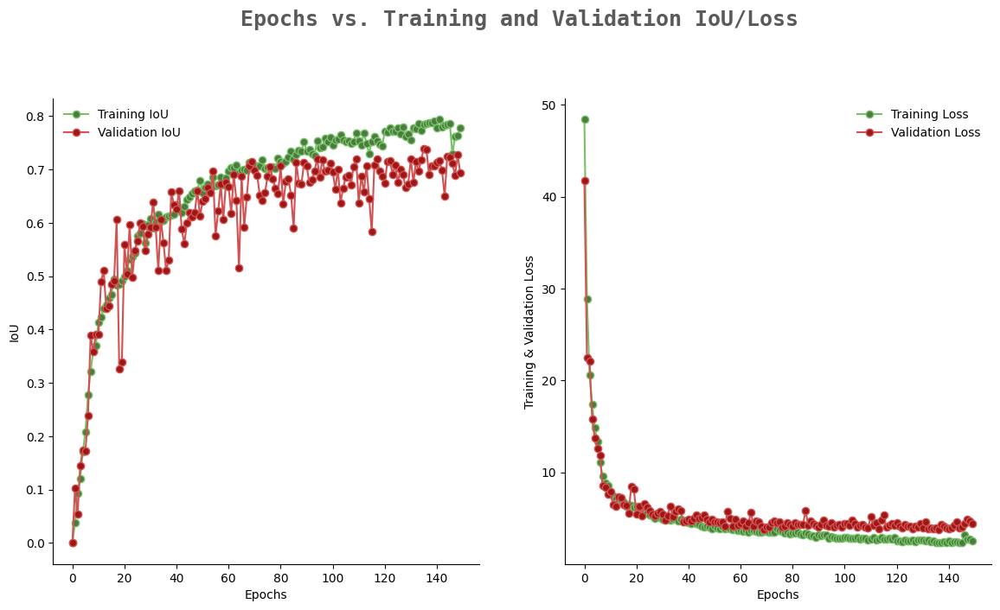

In [27]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(150)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [28]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_EFFNET/model_EFFNET.h5',compile = False)

In [29]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [30]:
model.evaluate(test_dataset)

15/15 [==============================] - 4s 35ms/step - loss: 4.7046 - IoU: 0.6786


[4.70463228225708, 0.6785749197006226]